# Sleep model

This notebook produces the plots in Fig. 4.

In [62]:
# change into the root directory of the project
import os
if os.getcwd().split("/")[-1] == "dev":
    os.chdir('..')

In [63]:
import logging
logger = logging.getLogger()
#import warnings
#warnings.filterwarnings("ignore")

logger.setLevel(logging.INFO)
#logging.disable(logging.WARNING)
#logging.disable(logging.WARN)

%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [4]:
import numpy as np
import matplotlib.pyplot as plt
plt.rcParams['image.cmap'] = 'plasma'
import scipy
from scipy import stats


from neurolib.models.aln import ALNModel
from neurolib.utils.parameterSpace import ParameterSpace
from neurolib.optimize.exploration import BoxSearch
import neurolib.utils.functions as func
import neurolib.utils.devutils as du

import neurolib.utils.brainplot as bp
import neurolib.optimize.exploration.explorationUtils as eu

from neurolib.utils.loadData import Dataset

In [5]:
from neurolib.utils import atlases
atlas = atlases.AutomatedAnatomicalParcellation2()

In [6]:
plt.style.use("paper")
plt.style.reload_library()

In [65]:
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['pdf.use14corefonts'] = True

In [7]:
# import matplotlib as mpl

# mpl.rcParams['axes.spines.left'] = True
# mpl.rcParams['axes.spines.right'] = True
# mpl.rcParams['axes.spines.top'] = True
# mpl.rcParams['axes.spines.bottom'] = True

In [8]:
ds = Dataset("gw_big", fcd=True)
model = ALNModel(Cmat = ds.Cmat, Dmat = ds.Dmat)
model.params['dt'] = 0.1
model.params['duration'] = 1 * 60 * 1000 #ms

INFO:root:Loading dataset gw_big from /Users/caglar/Documents/PhD/projects/neurolib/neurolib/utils/../data/datasets/gw_big.
INFO:root:Computing FCD matrices ...
INFO:root:Dataset gw_big loaded.
INFO:root:aln: Model initialized.


In [11]:
# Sleep model from newest evolution October 2020
model.params["mue_ext_mean"] = 3.3202829454334535
model.params["mui_ext_mean"] = 3.682451894176651
model.params["b"] = 3.2021806735984186
model.params["tauA"] = 4765.3385276559875
model.params["sigma_ou"] = 0.36802952978628106
model.params["Ke_gl"] = 265.48075753153

In [34]:
model.params["b"]+=0.5

# Run

In [ ]:
model.params['duration'] = 2 * 60 * 1000 #ms
model.run(chunkwise=True, chunksize=600000, bold = True)

In [36]:
# model.params['duration'] = 10 * 60 * 1000 #ms
# model.run()

In [35]:
# model.params['duration'] = 1 * 60 * 1000 #ms
# model.run()

In [48]:
# import datetime
# sim_name = "model" + datetime.datetime.now().strftime("-%Y-%m-%d-%HH-%MM-%SS")
# import dill
# dill.dump(model, open(f"data/models/sleep_model/{sim_name}.dill", "wb+"))
# print(f"{sim_name} saved.")

In [53]:
# import dill
# model = dill.load(open(f"data/models/sleep_model/model-2020-10-22-16H-09M-21S.dill", "rb"))

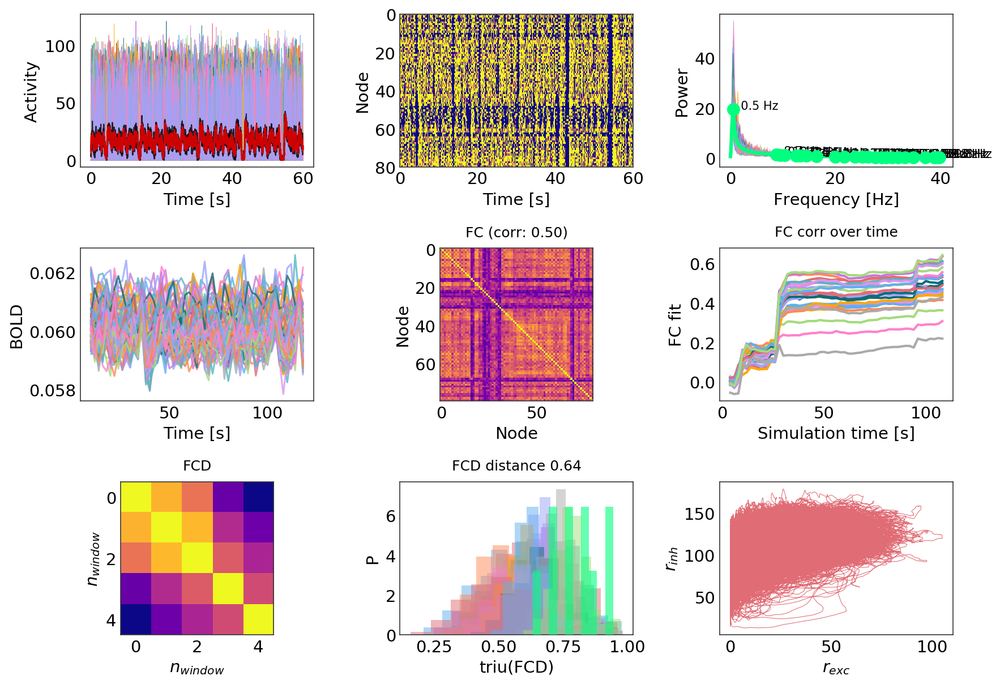

In [13]:
du.plot_outputs(model, ds, spectrum_windowsize=10) 

# Plot structural data

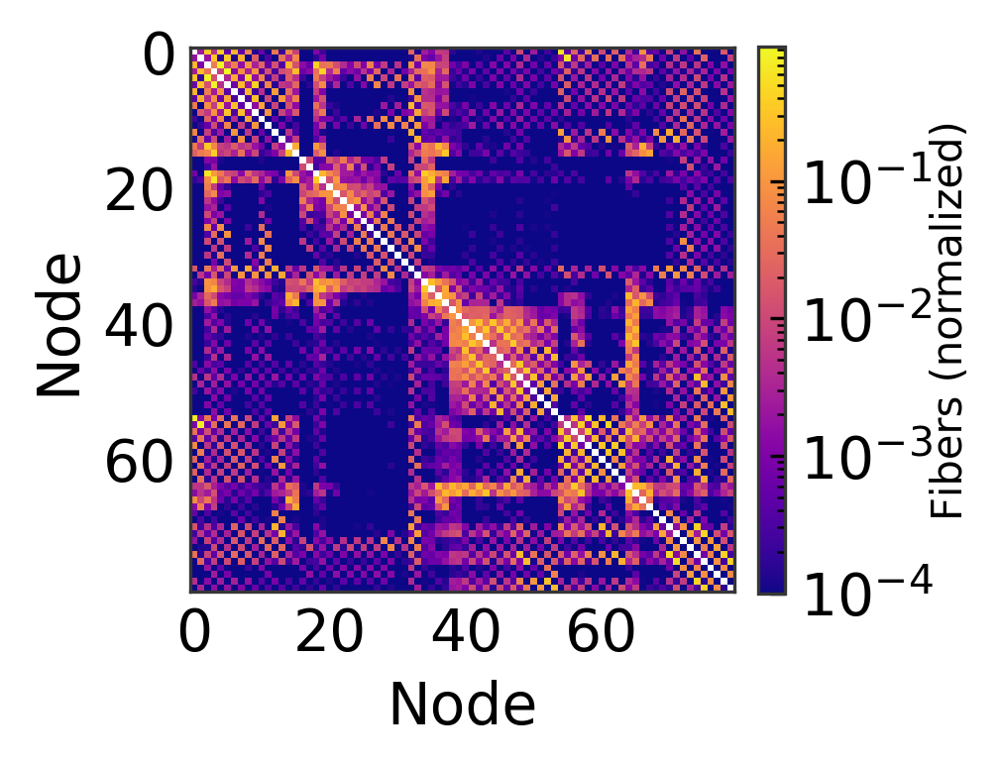

In [41]:
bp.plot_matrix(ds.Cmat, cbarlabel="Fibers (normalized)", plotlog=True)
plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl/SC.pdf")

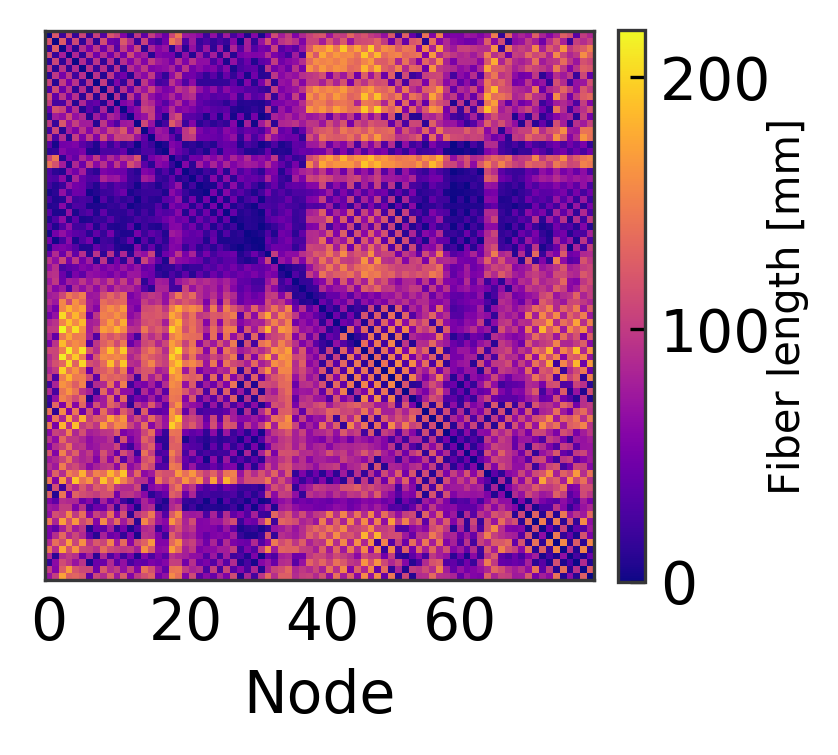

In [46]:
bp.plot_matrix(ds.Dmat, cbarlabel="Fiber length [mm]", ylabels=False)
plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl/DM.pdf")

## Fits: only for 12 mins simulation

In [197]:
fc_fits = du.model_fit(model, ds, bold_transient=10000, fcd=True)['fc_scores']
print(f"Best FC fit {np.max(fc_fits)}")
print(f"Mean FC fit {np.mean(fc_fits)}, std = {np.std(fc_fits)}")

Best FC fit 0.7099191548375675
Mean FC fit 0.5513859770408733, std = 0.11685230978350485


/Users/caglar/Documents/PhD/projects/neurolib/neurolib/utils/brainplot.py:1033: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


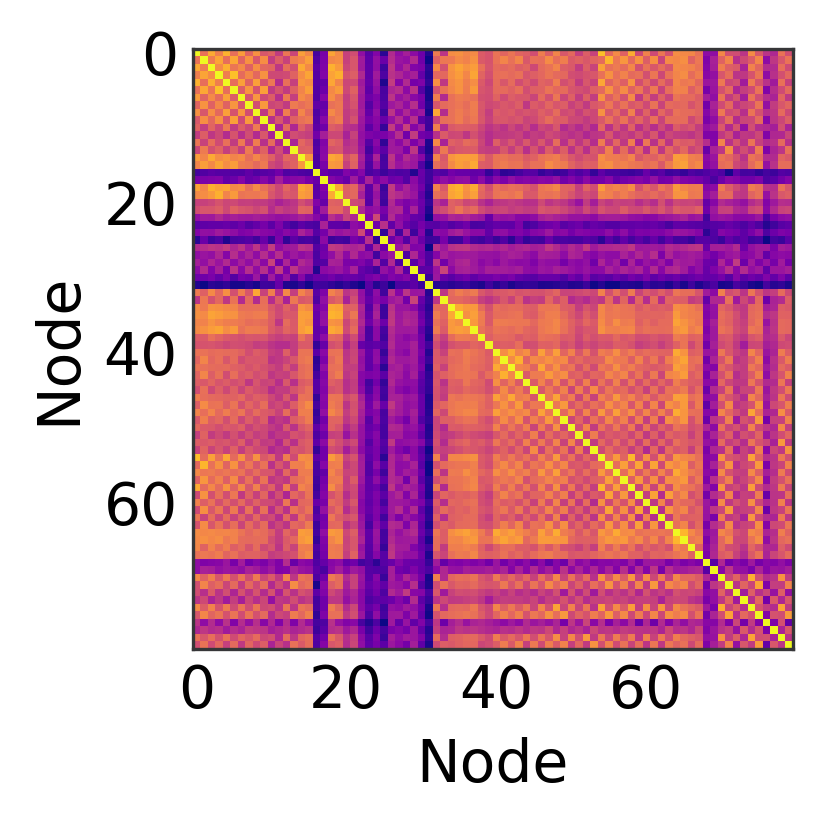

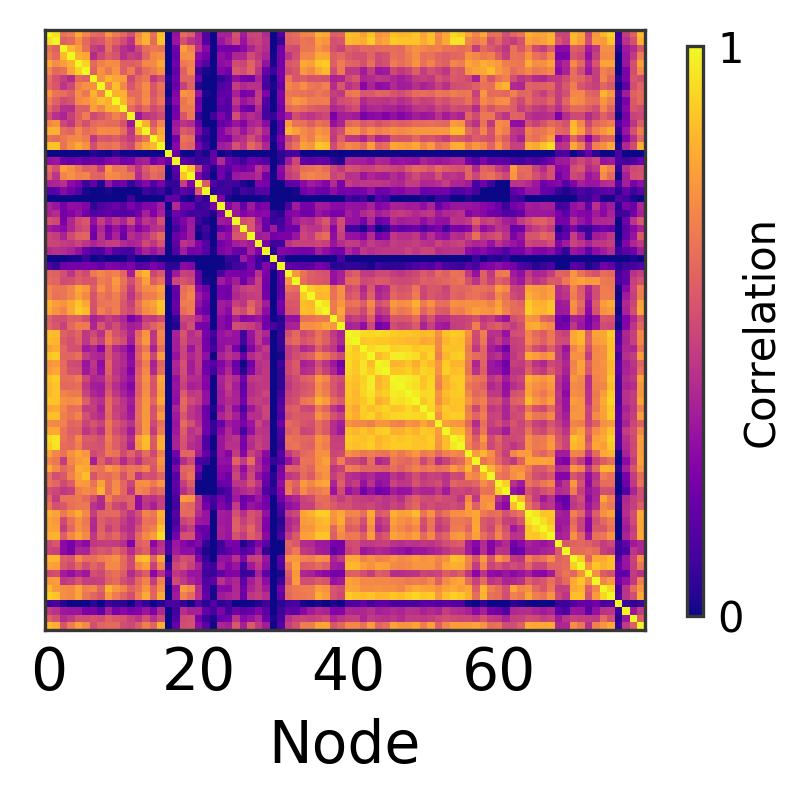

In [203]:
best_subject = np.argmax(du.model_fit(model, ds, bold_transient=10000, fc=True)['fc_scores'])

bp.plot_fc(model.BOLD.BOLD, model, bold_transient=10000)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_fits/assets/FC_sim.pdf")
bp.plot_fc(ds.BOLDs[best_subject], bold_transient=0, cbar=True, ylabels=False)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_fits/assets/FC_emp.pdf", bbox_inches = "tight")

In [204]:
fcd_fits = du.model_fit(model, ds, bold_transient=10000, fcd=True)['fcd']
print(f"Best FCD fit {np.min(fcd_fits)}")
print(f"Mean FCD fit {np.mean(fcd_fits)}, std = {np.std(fcd_fits)}")

Best FCD fit 0.06774475524475525
Mean FCD fit 0.2757554174220841, std = 0.16094828182122425


Best subject: 4
(65, 65)
(65, 65)


/Users/caglar/Documents/PhD/projects/neurolib/neurolib/utils/brainplot.py:1066: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(w_pad=4.5)


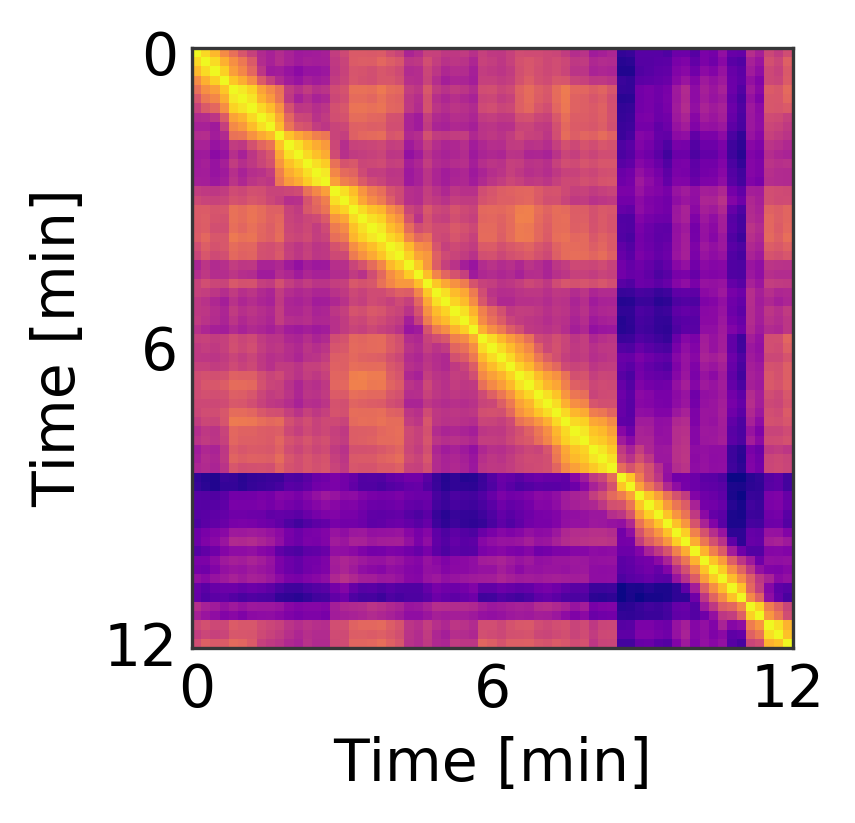

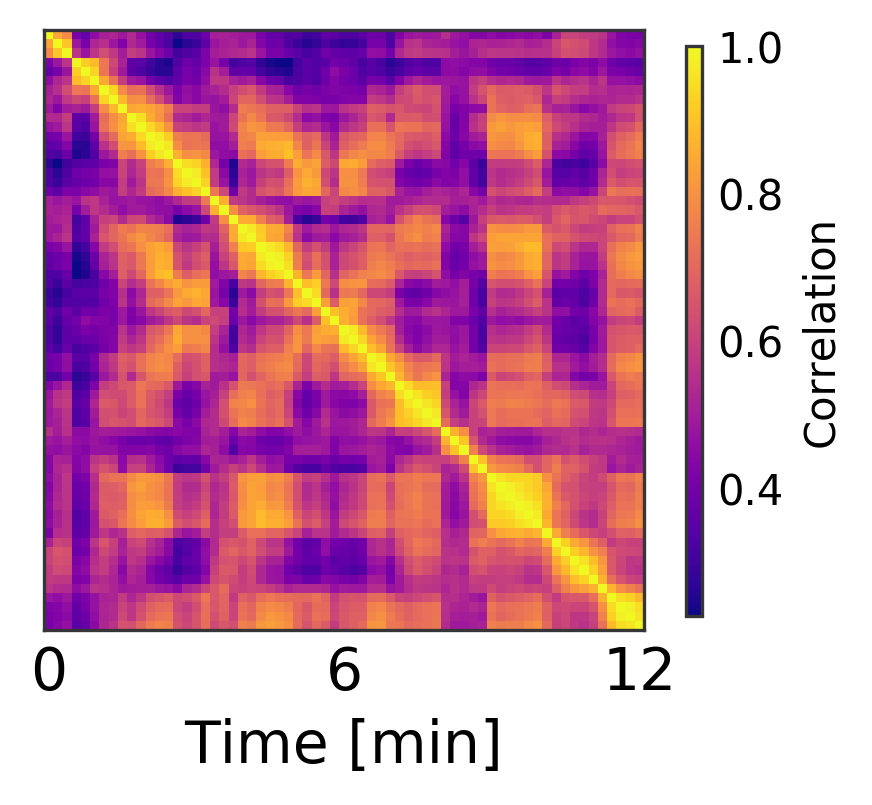

In [205]:
best_subject = np.argmin(du.model_fit(model, ds, bold_transient=10000, fcd=True)['fcd'])
print(f"Best subject: {best_subject}")

bp.plot_fcd(model.BOLD.BOLD, model=model, bold_transient=10000)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_fits/assets/FCD_sim.pdf")
bp.plot_fcd(ds.BOLDs[best_subject], bold_transient=0, cbar=True, ylabels=False)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_fits/assets/FCD_emp.pdf", bbox_inches = "tight")

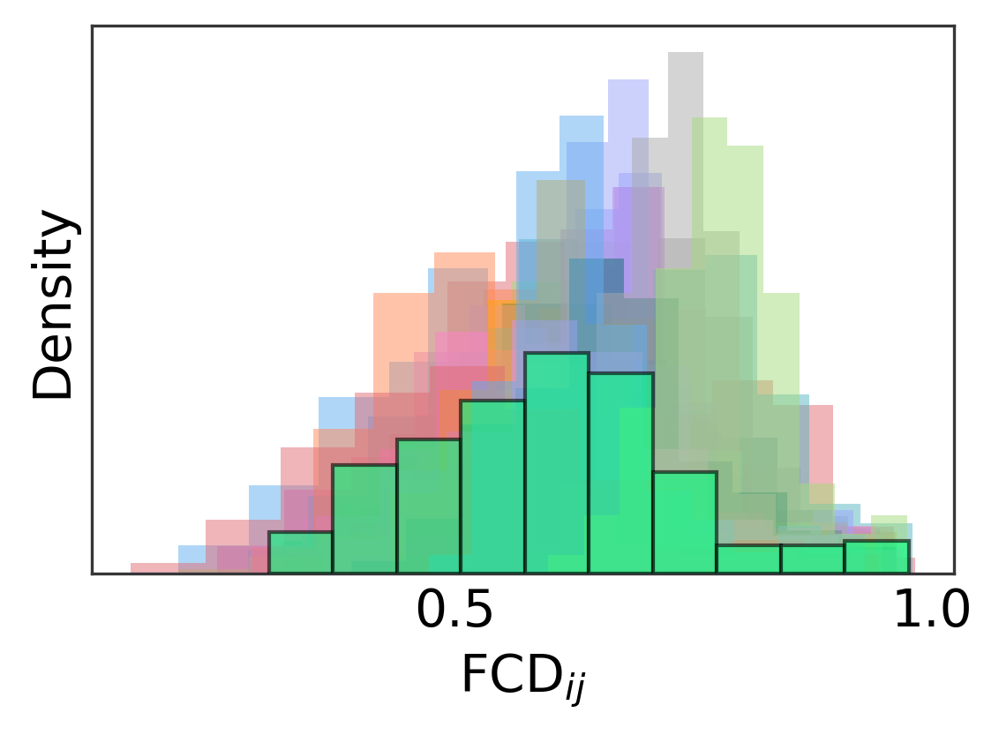

In [207]:
bp.plot_fcd_distribution(model, ds, bold_transient=10000,)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_fits/assets/FCD_distribution.pdf")

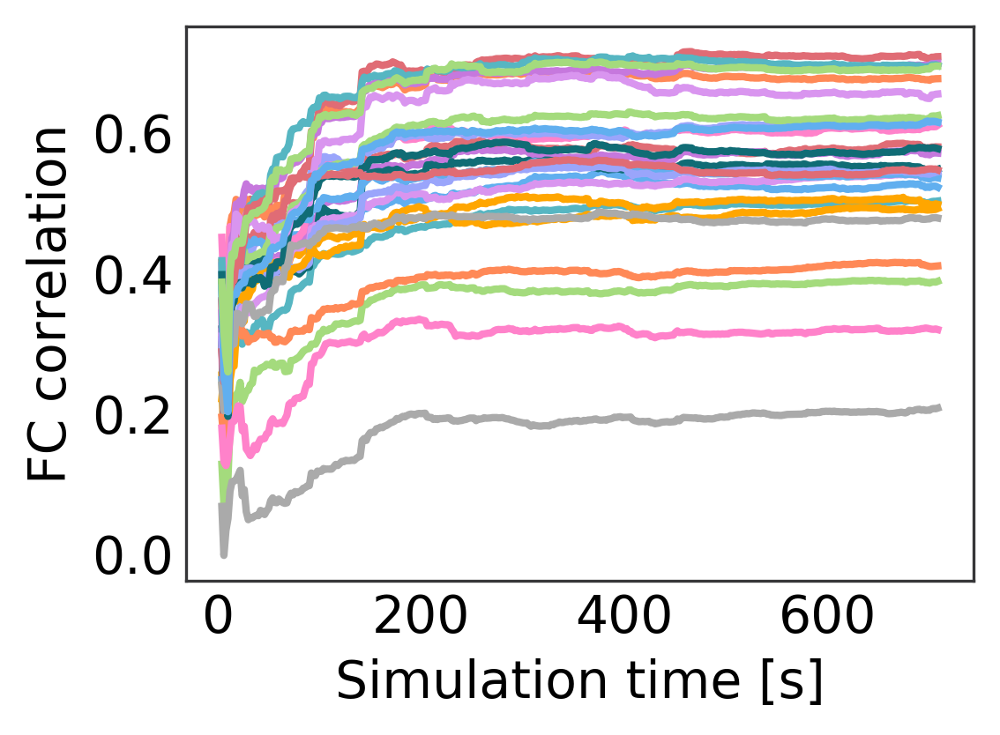

In [209]:
bp.plot_fc_over_time(model, ds, bold_transient=10000,)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_fits/assets/FC_time.pdf", bbox_inches = "tight")

In [ ]:
sc_cc = np.zeros((len(ds.Cmats), len(ds.Cmats)))
for i, sc1 in enumerate(ds.Cmats):
    for j, sc2 in enumerate(ds.Cmats):
        sc_cc[i, j] = func.matrix_correlation(sc1, sc2)
        
dm_cc = np.zeros((len(ds.Dmats), len(ds.Dmats)))
for i, sc1 in enumerate(ds.Dmats):
    for j, sc2 in enumerate(ds.Dmats):
        dm_cc[i, j] = func.matrix_correlation(sc1, sc2)        

In [ ]:
plt.figure(figsize=(2.5,2.5))
plt.imshow(sc_cc)
plt.xlabel("Subject")
plt.ylabel("Subject")
plt.colorbar(label="SC matrix correlation")
plt.title(f"Average correlation between \nsubjects: {np.mean(sc_cc[np.triu_indices(sc_cc.shape[0])]):0.2f}", fontsize=10)
plt.show()

In [ ]:
plt.figure(figsize=(2.5,2.5))
plt.imshow(dm_cc)
plt.xlabel("Subject")
plt.ylabel("Subject")
plt.colorbar(label="Length matrix correlation")
plt.title(f"Average correlation between \nsubjects: {np.mean(dm_cc[np.triu_indices(dm_cc.shape[0])]):0.2f}", fontsize=10)
plt.show()

## EEG data

In [85]:
# def eeg_correlation(model, stage="N3"):
#     import dill
#     f_eeg, mean_eeg_power = dill.load(open(f"./data/mean_eeg_power_{stage}.dill", "rb"))
#     model_frs, model_pwrs = func.getMeanPowerSpectrum(model.output, dt=model.params.dt, maxfr=40, spectrum_windowsize=10)
#     weights = [0.0] + list(1/model_frs[1:])
#     # 1/f weighted correlation
#     # eeg_correlation = func.weighted_correlation(mean_eeg_power, model_pwrs, weights)
#     # unweighted correlation
#     eeg_correlation = np.corrcoef(mean_eeg_power, model_pwrs)[0,1]
#     return eeg_correlation

def eeg_correlation_subjects(model, stage="N3"):
    eeg_spectra = dill.load(open(f"./data/all_stage_eeg_power_pectra.dill", "rb"))
    subject_spectra = eeg_spectra[1][stage]['powerspecs']
    model_frs, model_pwrs = func.getMeanPowerSpectrum(model.output, dt=model.params.dt, maxfr=40, spectrum_windowsize=10)
    corrs = []
    for subject_spectrum in subject_spectra:
        eeg_correlation = np.corrcoef(subject_spectrum, model_pwrs)[0,1]
        corrs.append(eeg_correlation)
    return corrs

In [86]:
# stages = ["Wa", "N1", "N2", "N3", "N4"]
# corrs = []
# for stage in stages:
#     corr = eeg_correlation(model, stage)
#     corrs.append(corr)
#     print(f"Stage {stage}: {corr:0.2f}")

In [115]:
stages = ["Wa", "N1", "N2", "N3", "N4"]
stages = ["Wa", "N1", "N2", "N3"]


subject_corrs = []
mean_corrs = []
std_corrs = []
for stage in stages:
    corrs = eeg_correlation_subjects(model, stage)
    subject_corrs.append(corrs)
    mean_corrs.append(np.mean(corrs))
    std_corrs.append(np.std(corrs))
    print(f"Stage {stage} ({len(corrs)} samples): {np.mean(corrs):0.2f} +- {np.std(corrs):0.2f}")

Stage Wa (52 samples): 0.47 +- 0.11
Stage N1 (55 samples): 0.48 +- 0.08
Stage N2 (55 samples): 0.66 +- 0.12
Stage N3 (29 samples): 0.86 +- 0.07


In [116]:
from scipy import stats
for n in range(4):
    print(f"{n}, {n+1}", stats.ttest_ind(subject_corrs[n+0], subject_corrs[n+1], equal_var = False))

0, 1 Ttest_indResult(statistic=-0.4174894025595181, pvalue=0.6772583469675147)
1, 2 Ttest_indResult(statistic=-8.681747769610283, pvalue=1.124892685658679e-13)
2, 3 Ttest_indResult(statistic=-9.35154436641257, pvalue=1.771815763960389e-14)


IndexError: list index out of range

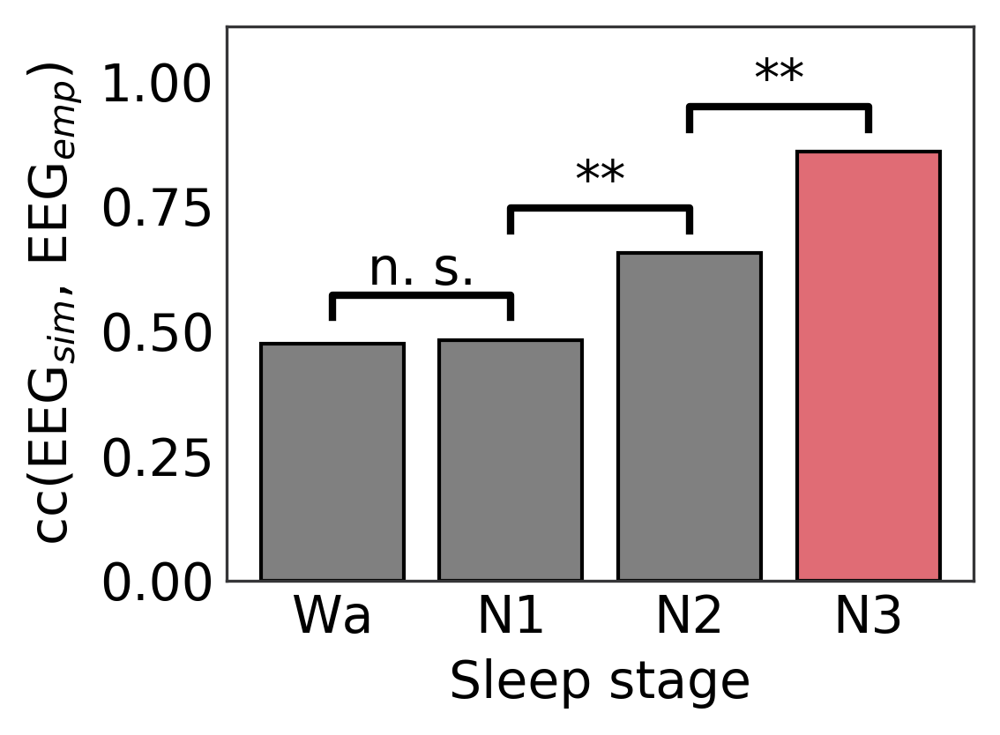

In [125]:
plt.figure(figsize=(4, 3))
#plt.bar(stages, mean_corrs, yerr=std_corrs)
#plt.bar(stages, mean_corrs, color=["gray", "gray", "gray", "C0", "gray"], edgecolor='k')
plt.bar(stages, mean_corrs, color=["gray", "gray", "gray", "C0"], edgecolor='k')
bp.barplot_annotate_brackets(0, 1, 0.68, range(len(stages)), mean_corrs)
bp.barplot_annotate_brackets(1, 2, 1e-12, range(len(stages)), mean_corrs, maxasterix=2)
bp.barplot_annotate_brackets(2, 3, 1e-13, range(len(stages)), mean_corrs, maxasterix=2)
#bp.barplot_annotate_brackets(3, 4, 0.02, range(len(stages)), mean_corrs, maxasterix=2)
plt.ylim(0, 1.11)
plt.ylabel("cc(EEG$_{sim}$, EEG$_{emp}$)")
plt.xlabel("Sleep stage")
plt.tight_layout()
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_fits/assets/EEG_correlations_N3.pdf", bbox_inches = "tight")

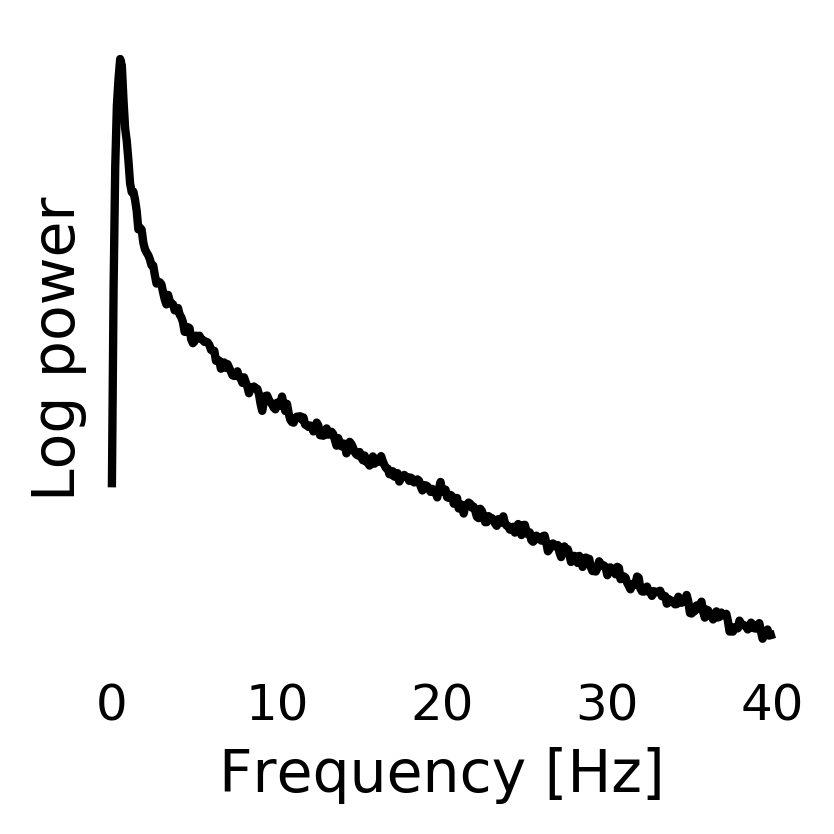

In [113]:
model_frs, model_pwrs = func.getMeanPowerSpectrum(model.output, dt=model.params.dt, maxfr=40, spectrum_windowsize=10)
#bp.plot_powerspectra(model_frs, [], model_pwrs, logy=True, savename="sleep_model_powerspec.pdf")

# Plots

## Average timeseries

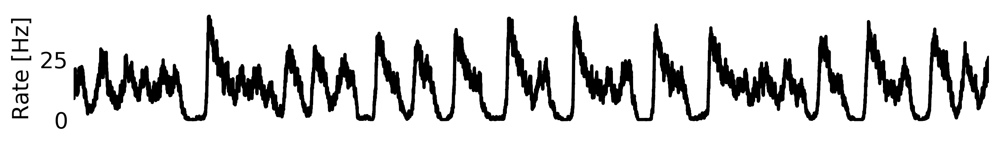

In [36]:
bp.plot_average_timeseries(model, xticks=False, kwargs={"c" : "k"})
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/average_rate.pdf", transparent=True)

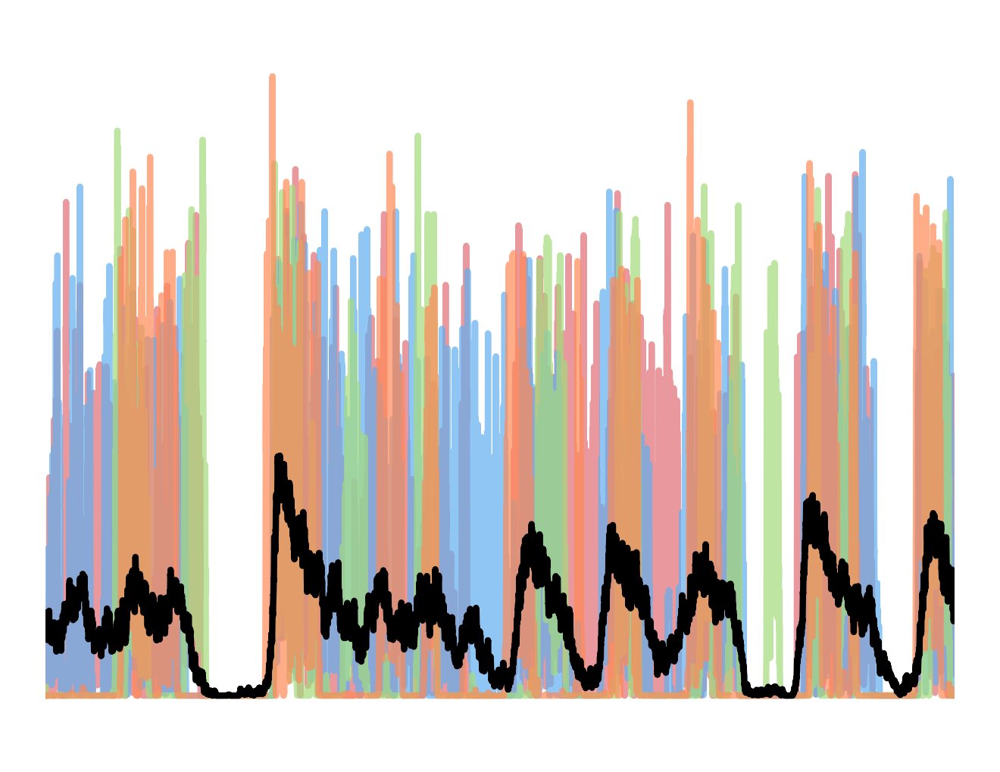

In [52]:
bp.plot_ts(model, figsize=(2, 1.5), plot_nodes=[0, 3, 31, 25], plot_alpha=0.7, plot_mean_background=True, mean_alpha=1.0)
plt.xlim(4, 23)
plt.xticks([])
plt.yticks([])
plt.savefig("/Users/caglar/neurolib/data/figures/Fig1_firing_rate.pdf")

## States

In [55]:
#up_thresh = 0.01
#threshold_per_node = up_thresh * np.max(model.output, axis=1) # as per Nghiem et al., 2020, Renart et al., 2010
states = bp.detectSWs(model, filter_long=True)

durations = bp.get_state_lengths(states)
ups, downs = bp.get_updown_lengths(durations)

#involvement =  1 - np.sum(states, axis=0) / states.shape[0]
involvement = bp.get_involvement(states)

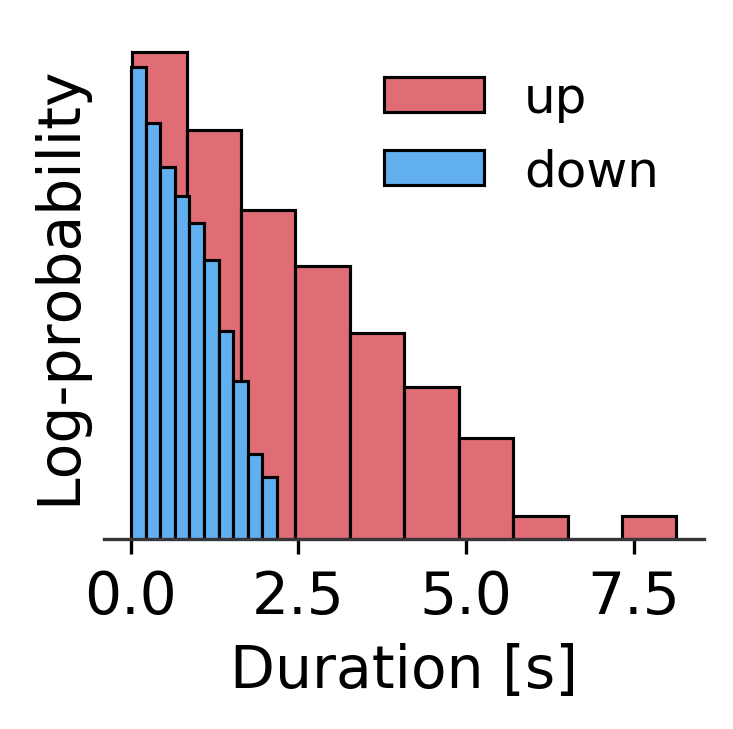

In [56]:
bp.plot_state_durations(model, states)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/duration_distribution.pdf", transparent=True)

slope = 0.5019361753210486, intercept = 0.48398622831930127, r_value = 0.2509759447342773, p_value = 0.0, std_err = 0.008663530959906513


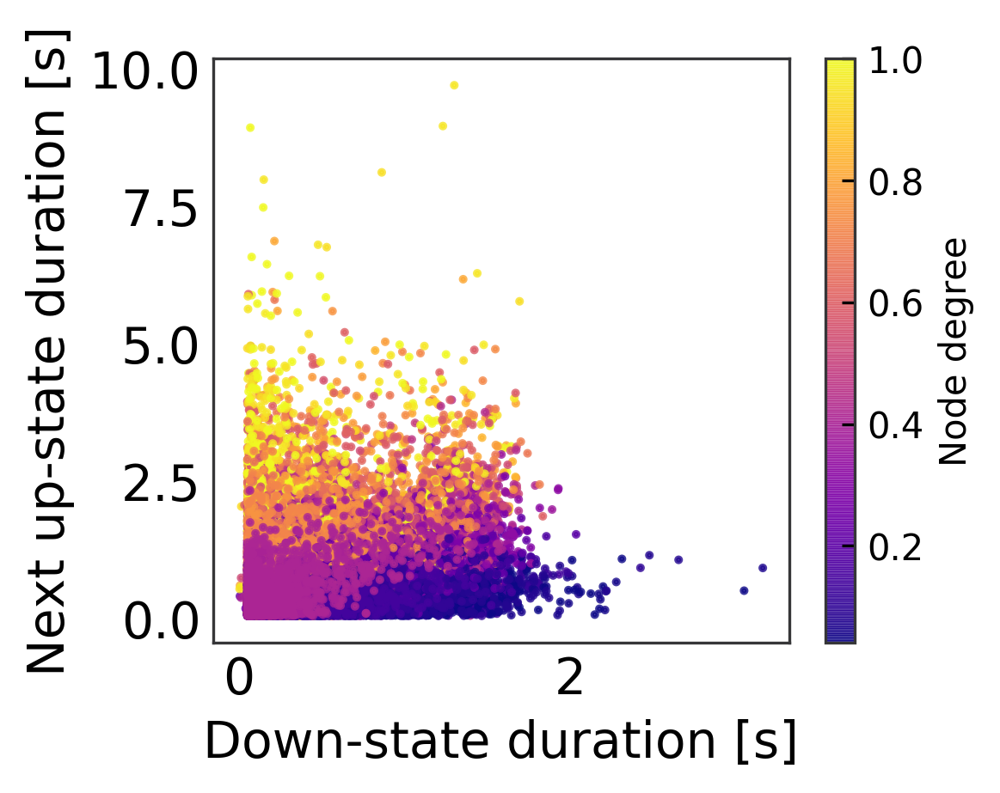

In [86]:
durations = bp.get_state_lengths(states)
ups, downs = bp.get_updown_lengths(durations)
bp.plot_down_up_durations(model, durations, ds)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/up_down_durations.pdf")

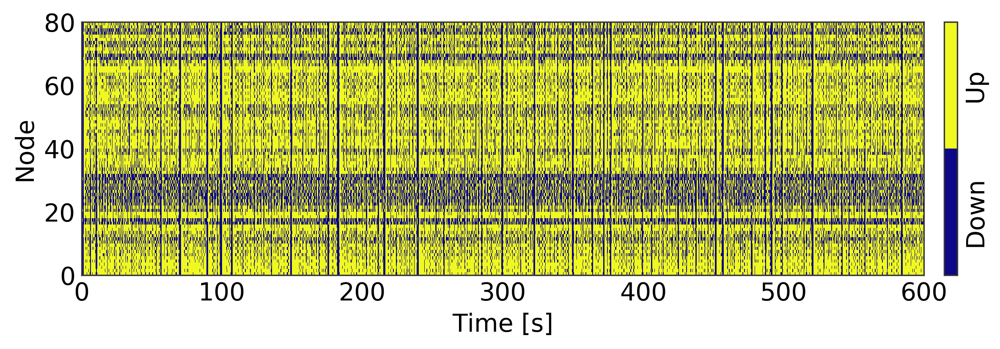

In [40]:
bp.plot_states_timeseries(model, states, cmap="plasma")
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/state_timeseries.pdf", transparent=True)

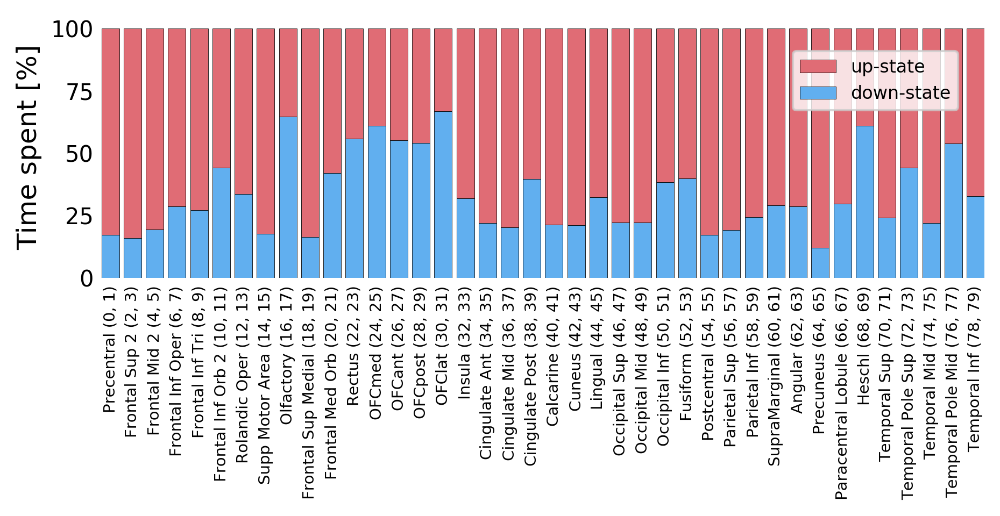

In [41]:
area_downtimes, area_uptimes = bp.plot_state_brain_areas(model, states, atlas, ds)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_sleep_model/brain_ares_durations.pdf")

## Involvement

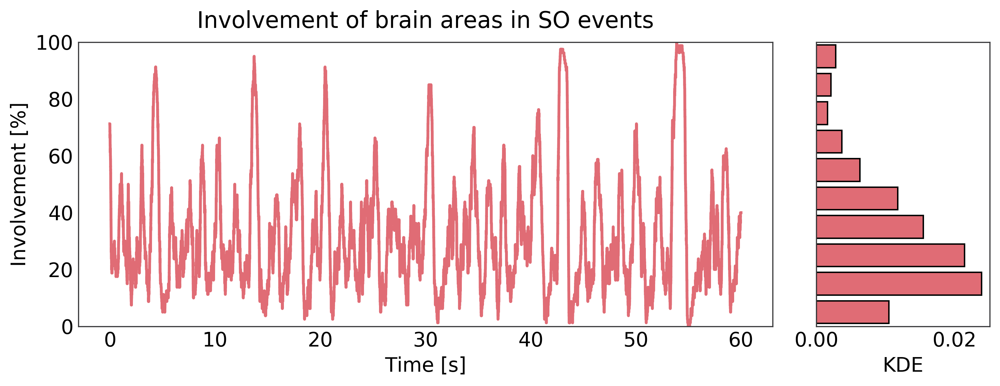

In [469]:
bp.plot_involvement_timeseries(model, involvement)

In [89]:
print("Mean involvement: ", np.mean(involvement))

Mean involvement:  0.3303970895833334


In [90]:
print(np.sum(involvement<0.5)/len(involvement)*100, "% of slow oscillations were detected in less than 50% of regions")

81.12306666666666 % of slow oscillations were detected in less than 50% of regions


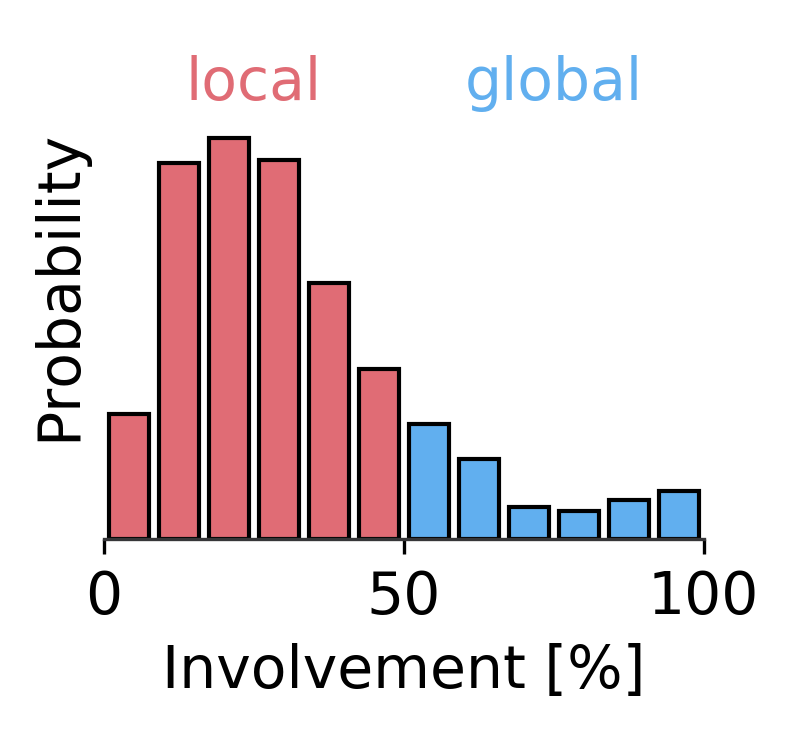

In [61]:
bp.plot_involvement_distribution(model, involvement, remove_xticks=True, color_localglobal=True)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/involvement.pdf", transparent=True)

# Length of states vs involvement

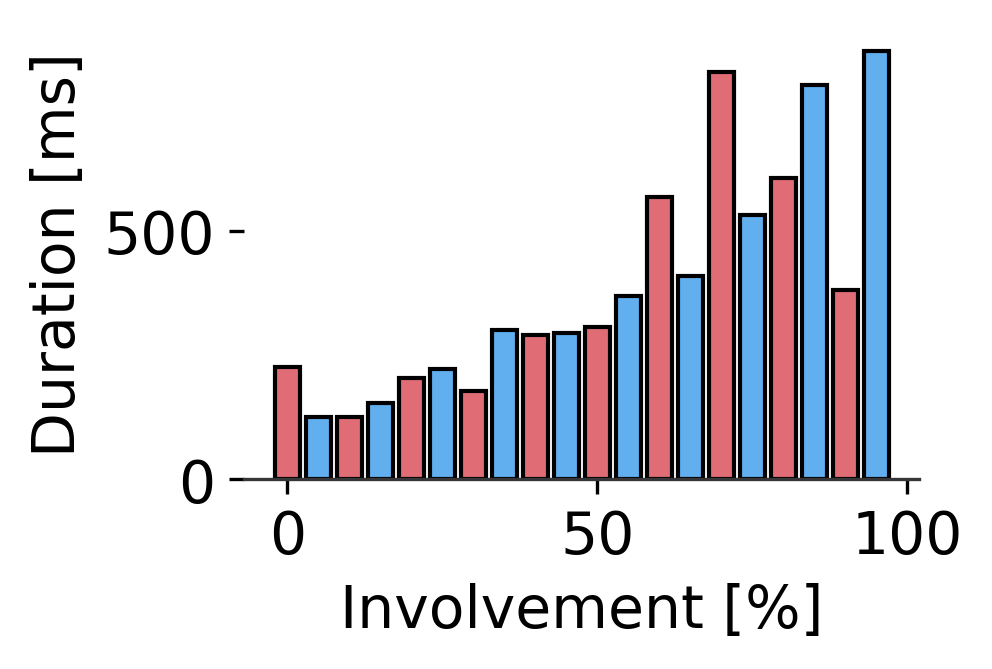

In [80]:
bp.plot_involvement_durations(model, states, involvement, nbins=10)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/involvement_duration.pdf", transparent=True)

## State durations in brain areas

<Figure size 600x600 with 0 Axes>

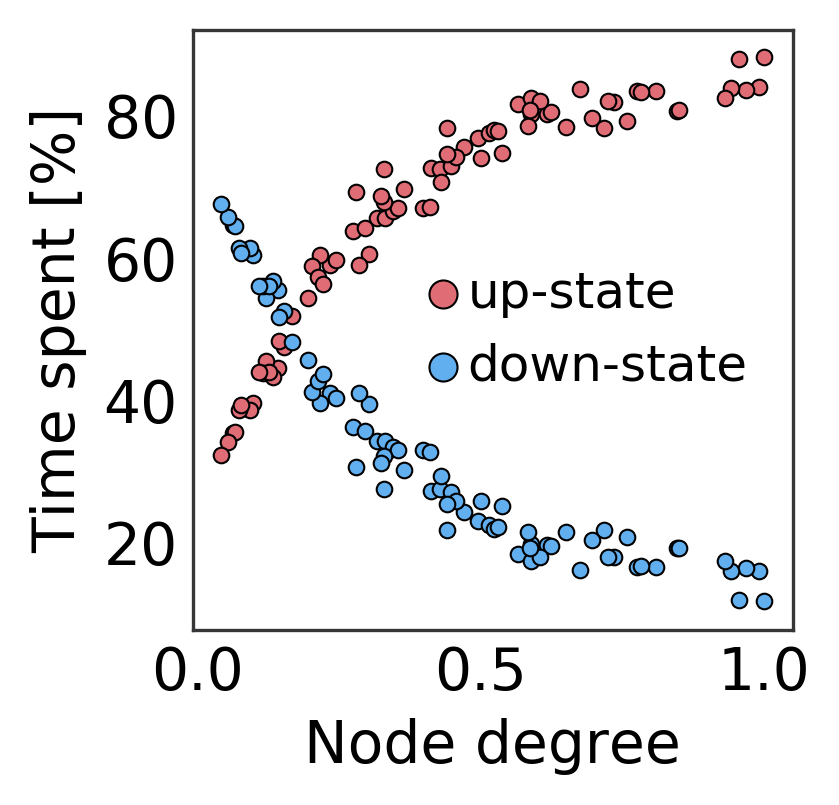

In [138]:
bp.plot_degree_duration_scatterplot(model, states, ds, color_up="C0",  color_down="C1")
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/degree_duration.pdf", transparent=True)

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 0/6000 [00:00<?, ?it/s]/Users/caglar/anaconda/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
  0%|          | 1/6000 [00:00<08:01, 12.47it/s]


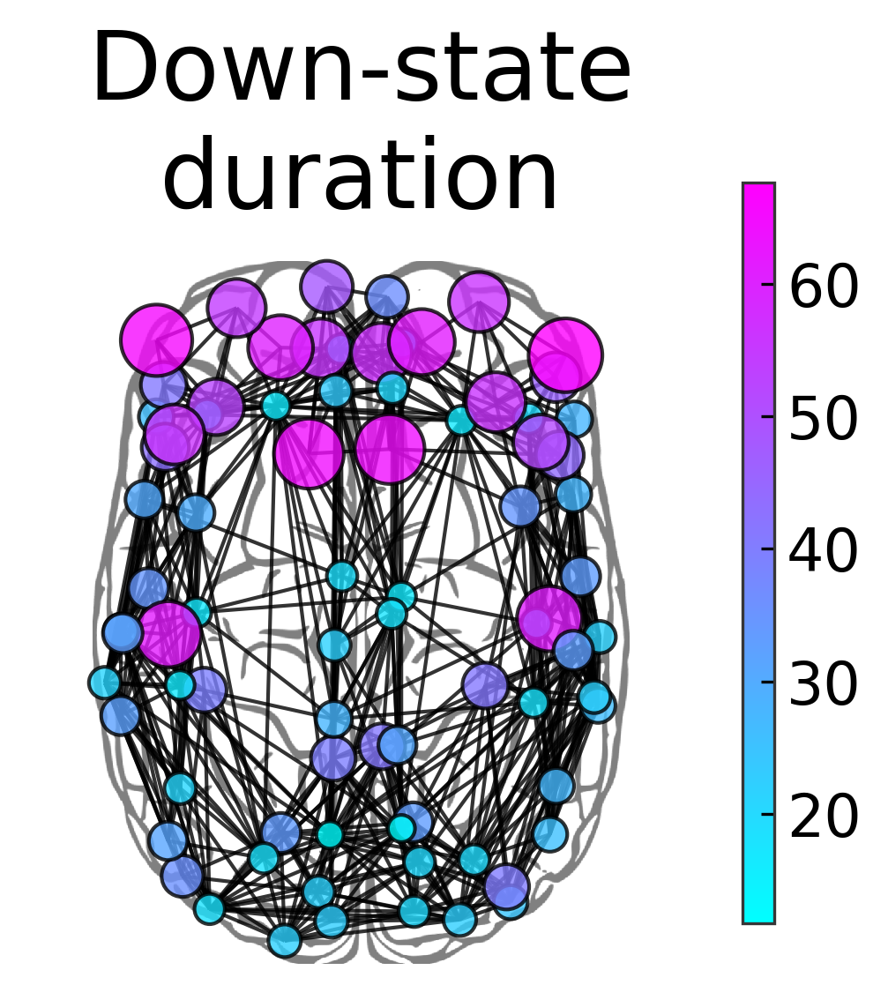

In [137]:
degrees = [np.sum(ds.Cmat[i, :]) * 100 for i in range(model.params.N)]
mean_states =  np.mean(states, axis=1) * 1000
len_states = np.sum(states, axis=1) * model.params.dt / 1000

normalized_down_lengths = model.params.duration / 1000 - len_states
normalized_down_lengths = normalized_down_lengths / (model.params.duration / 1000) * 100 # to percent

bp.plot_brain(model, ds, color=normalized_down_lengths, title='Down-state\nduration', cmap='cool')
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/brain_state_durations.pdf", transparent=True)

In [95]:
#area_downtimes, area_uptimes = bp.plot_state_brain_areas(model, states, atlas, ds)    

## Involvement / amplitude

slope = -0.25717839047322827, intercept = 24.12328296809941, r_value = -0.9161474101821243, p_value = 0.0, std_err = 0.0022978264533539045


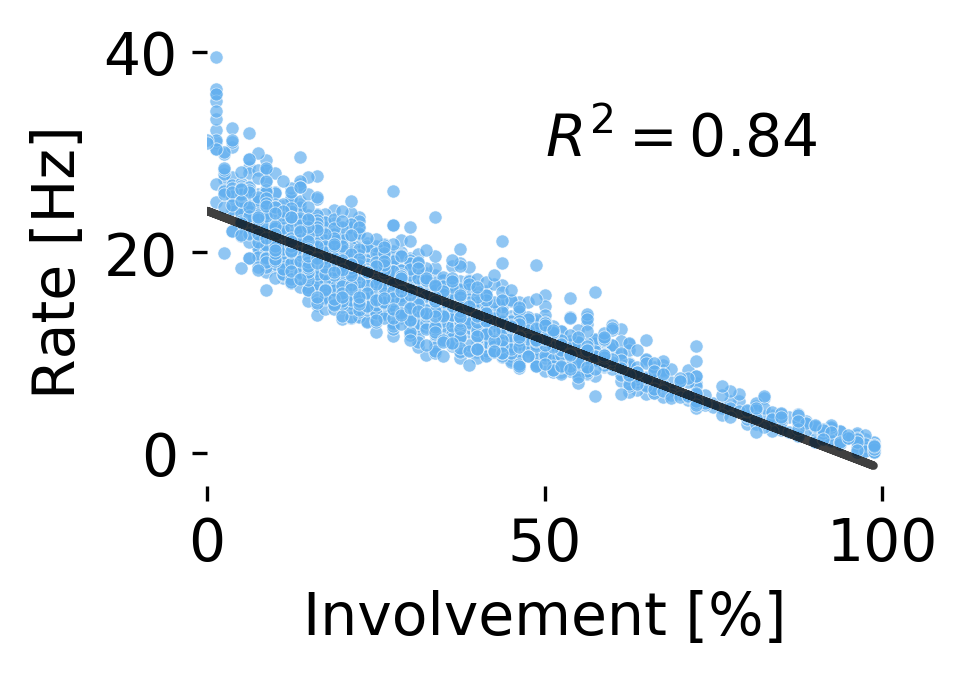

In [78]:
bp.plot_involvement_mean_amplitude(model, involvement, skip=250)    
#plt.tight_layout()
# skip = 10
# slope, intercept, r_value, p_value, std_err = bp.plot_linregress(involvement[::skip] * 100, np.mean(model.output, axis=0)[::skip], kwargs = {"c" : "k", 'alpha' : 0.75})
# plt.text(50, 30, f"$R^2={r_value**2:0.2f}$")
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/involvement_amplitude.pdf", transparent=True)

## Duration of successive states

In [436]:
# durations = bp.get_state_lengths(states)
# ups, downs = bp.get_updown_lengths(durations)
# bp.plot_down_up_durations(model, durations, ds)

# Degree and direction of wave

In [48]:
degrees =  [(np.sum(ds.Cmat, axis=1))[i] / np.max(np.sum(ds.Cmat, axis=1)) for i in range(len(ds.Cmats[0]))]

In [49]:
coords = atlas.coords()

x: slope 2.0187923933718386, r_value 0.011876598288188432, p_value 0.9167254919886056
y: slope -71.80934977550803, r_value -0.31861958874148794, p_value 0.003971160354006569
z: slope 60.86555972845306, r_value 0.5306777876425544, p_value 4.117193945735481e-07


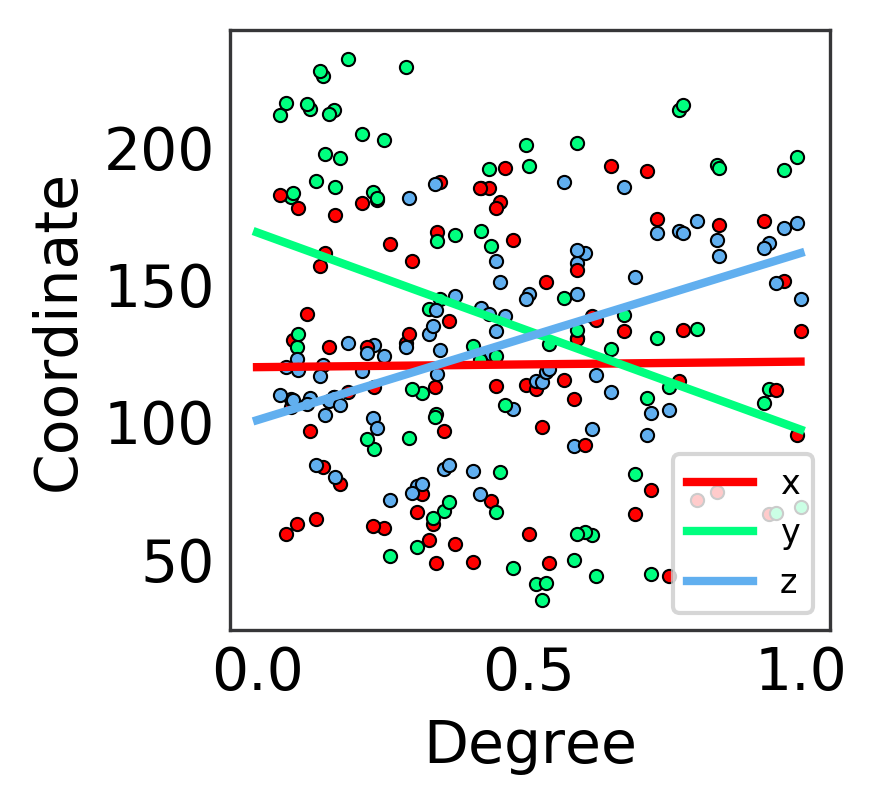

In [54]:
max_down = np.max(degrees)
figsize=(2, 2)
plt.figure(figsize=figsize)
for i in range(model.params.N):
    plt.scatter(degrees[i], coords[i][0], c='red', s=10, edgecolor='k', linewidths=0.5)
    plt.scatter(degrees[i], coords[i][1], c='springgreen', s=10, edgecolor='k', linewidths=0.5)
    plt.scatter(degrees[i], coords[i][2], c='C1', s=10, edgecolor='k', linewidths=0.5)
slope, intercept, r_value, p_value, std_err = stats.linregress(degrees, [c[0] for c in coords])
plt.plot([0, max_down], [intercept, intercept + max_down *slope], c='red', label='x')
print(f"x: slope {slope}, r_value {r_value}, p_value {p_value}")
slope, intercept, r_value, p_value, std_err = stats.linregress(degrees, [c[1] for c in coords])
plt.plot([0, max_down], [intercept, intercept + max_down *slope], c='springgreen', label='y')        
print(f"y: slope {slope}, r_value {r_value}, p_value {p_value}")
slope, intercept, r_value, p_value, std_err = stats.linregress(degrees, [c[2] for c in coords])
plt.plot([0, max_down], [intercept, intercept + max_down * slope], c='C1', label='z')   
print(f"z: slope {slope}, r_value {r_value}, p_value {p_value}")
plt.legend(fontsize=8)
plt.xlabel("Degree")
plt.ylabel("Coordinate")
plt.tight_layout()
bp.set_axis_size(*figsize)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl/degree_coordinate.pdf", transparent=True)

## Phase of involvement

In [92]:
import xarray as xr

In [93]:
inv_xr = xr.DataArray(involvement, coords=[model.t], dims=[ "time"])

In [94]:
from neurolib.utils.signal import Signal

In [95]:
sig = Signal(inv_xr, time_in_ms=True)

In [96]:
def get_phase(signal, filter_args, pad=None):
    """
    Extract phase of the signal. Steps: detrend -> pad -> filter -> Hilbert
    transform -> get phase -> un-pad.
    :param signal: signal to get phase from
    :type signal: `neuro_signal.Signal`
    :param filter_args: arguments for `Signal`'s filter method (see its
        docstring)
    :type filter_args: dict
    :param pad: how many seconds to pad, if None, won't pad
    :type pad: float|None
    :return: wrapped Hilbert phase of the signal
    :rtype: `neuro_signal.Signal`
    """
    assert isinstance(signal, Signal)
    phase = signal.detrend(inplace=False)
    if pad:
        phase.pad(
            how_much=pad, in_seconds=True, padding_type="reflect", side="both"
        )
    phase.filter(**filter_args)
    phase.hilbert_transform(return_as="phase_wrapped")
    if pad:
        phase.sel([phase.start_time + pad, phase.end_time - pad])
    return phase

phase = get_phase(sig, filter_args={"low_freq": 0.5, "high_freq": 2})

Setting up band-pass filter from 0.5 - 2 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 2.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 66001 samples (6.600 sec)



In [97]:
node_mean_phases_down, node_mean_phases_up = bp.get_transition_phases(states, phase.data)

Node 0: mean_down_phase = -0.8905344841419627, mean_up_phase = 0.8691737609167705
Node 1: mean_down_phase = -1.1123773427743346, mean_up_phase = 0.5312607265965705
Node 2: mean_down_phase = -1.06860428933981, mean_up_phase = 0.3176167454424208
Node 3: mean_down_phase = -1.283049206591674, mean_up_phase = 0.5817932044769014
Node 4: mean_down_phase = -1.1470061832883596, mean_up_phase = 0.8555752049033973
Node 5: mean_down_phase = -0.93076871192986, mean_up_phase = 1.1054907280719384
Node 6: mean_down_phase = -1.818160556447877, mean_up_phase = 1.5850221721870366
Node 7: mean_down_phase = -1.301565384569327, mean_up_phase = 1.222327065085289
Node 8: mean_down_phase = -1.4333462559263763, mean_up_phase = 0.6899234212949774
Node 9: mean_down_phase = -1.404035735861083, mean_up_phase = 1.6099566368724378
Node 10: mean_down_phase = -2.063975695727851, mean_up_phase = 2.338981637686305
Node 11: mean_down_phase = -1.808003430091299, mean_up_phase = 2.384846000169424
Node 12: mean_down_phase = 

In [98]:
node_mean_phases_down = np.array(node_mean_phases_down)
node_mean_phases_up = np.array(node_mean_phases_up)

In [99]:
# modulo all up phases with positive pi, and vice versa
if np.any(node_mean_phases_up<0) or np.any(node_mean_phases_down>0):
    logging.warning("Modulo was necessary")
node_mean_phases_up= np.mod(node_mean_phases_up, np.pi)
node_mean_phases_down = np.mod(node_mean_phases_down, -np.pi)

INFO:root:Defaulting to 600 frames at 10 fp/s
  0%|          | 0/600 [00:00<?, ?it/s]/Users/caglar/anaconda/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:579: MatplotlibDeprecationWarning: 
The iterable function was deprecated in Matplotlib 3.1 and will be removed in 3.3. Use np.iterable instead.
  if not cb.iterable(width):
  0%|          | 1/600 [00:00<00:59, 10.10it/s]


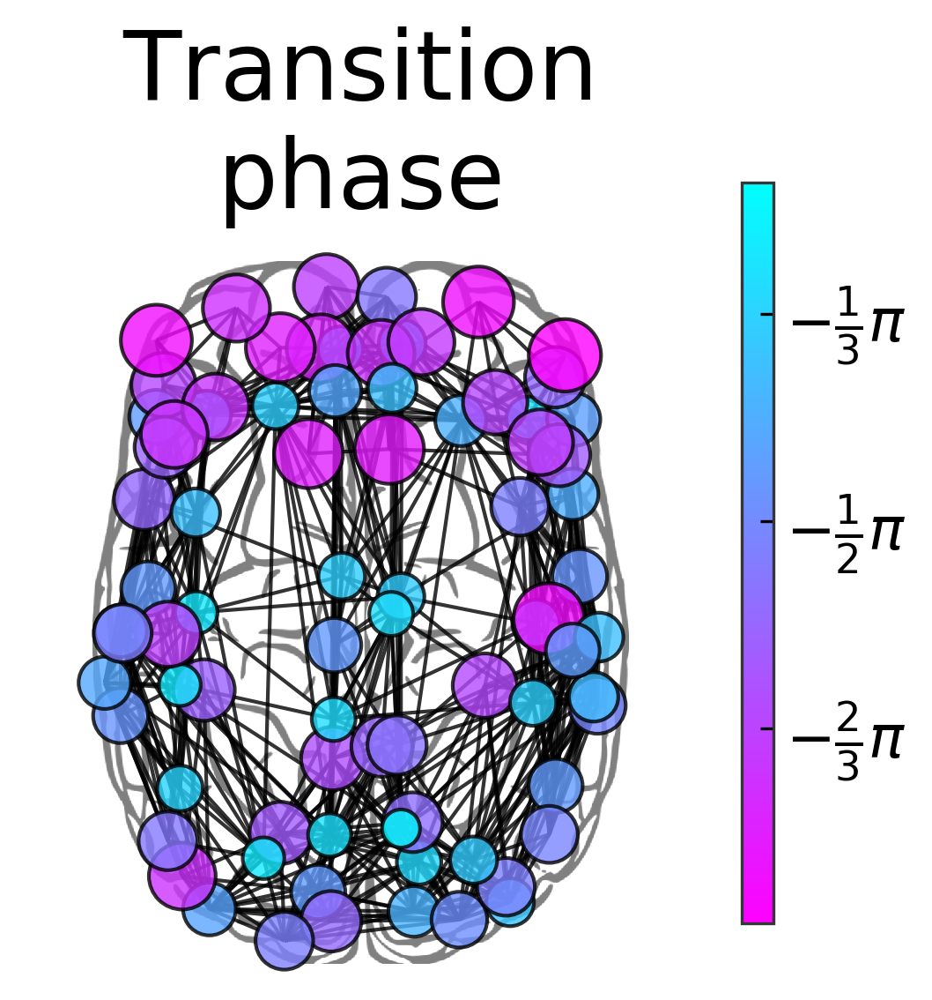

In [100]:
bp.plot_brain(model, ds, color=node_mean_phases_down, size=np.multiply(-150, node_mean_phases_down), title="Transition\nphase", cmap='cool_r', cbarticks=[- 1/3 * np.pi, -np.pi/2, - 2/3 * np.pi], cbarticklabels=["$-\\frac{1}{3}\\pi$", "$-\\frac{1}{2}\\pi$", "$-\\frac{2}{3}\\pi$"])
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/brain_mean_phase.pdf", transparent=True)

In [101]:
coords = atlas.coords()
minmax_coords = [int(np.min([c[1] for c in coords])), int(np.max([c[1] for c in coords]))]
# slope, intercept, r_value, p_value, std_err = stats.linregress([c[1] for c in coords], node_mean_phases_down)

Down transitions: slope: 0.0029600767009973277 r: 0.36410403059456925, p: 0.0008997309369366199
Up transitions: slope: -0.003496419422670482 r: -0.24825725731178566, p: 0.026390384980484672
coordinates: [34, 232]


([<matplotlib.axis.YTick at 0x7f9439d74048>,
 <a list of 3 Text yticklabel objects>)

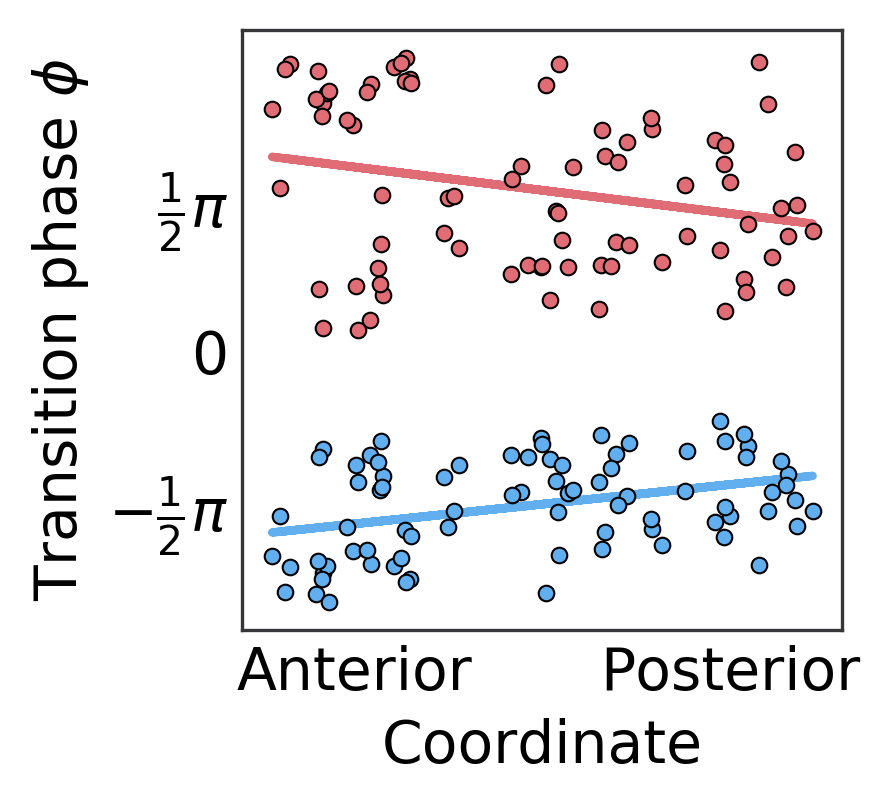

In [102]:
down_slope, down_intercept, down_r_value, down_p_value, down_std_err, \
up_slope, up_intercept, up_r_value, up_p_value, up_std_err \
    = bp.phase_transition_coordinate(node_mean_phases_down, node_mean_phases_up, atlas)
print(f"coordinates: {minmax_coords}")
plt.yticks([-np.pi/2, 0, np.pi/2], ["$-\\frac{1}{2}\\pi$", 0, "$\\frac{1}{2}\\pi$"])
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/coordinate_phase.pdf", transparent=True)

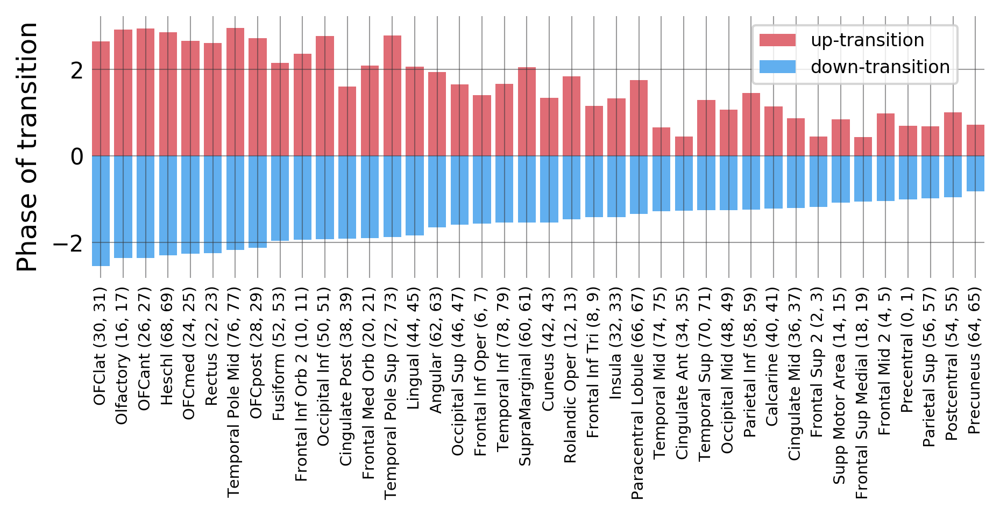

In [103]:
bp.plot_transition_phases(node_mean_phases_down, node_mean_phases_up, atlas)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/suppl_sleep_model/transition_phases.pdf", transparent=True)

# Phases, synchronization

The transition into the up-state is faster than the transition to the down-state. This is measured by the amount of time it takes on average to reach the up-state from the down-state and vice versa.

In [104]:
percent_down = float(np.sum(phase.data > 0) / np.sum(phase.data < 0)) * 100

In [105]:
# plt.figure(figsize=(4, 1))
# plt.vlines(np.where(up_transitions[0])[0]*model.params.dt/1000,0, 1)

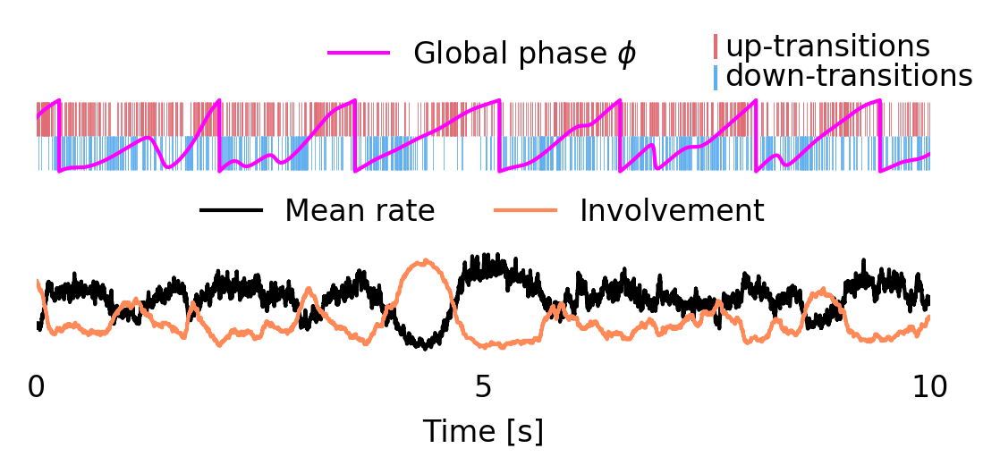

In [106]:
bp.plot_phases_and_involvement(model, involvement, phase.data, states)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/timeseries_rate_involvement_phase.pdf", transparent=True)

Nodes that transition to the down-state first, tend to be the ones that come back to the up-state last.

slope = -1.6599753060090687, intercept = -1.0222668259075622, r_value = -0.9684892957576479, p_value = 7.570128170439475e-49, std_err = 0.04833426118829515


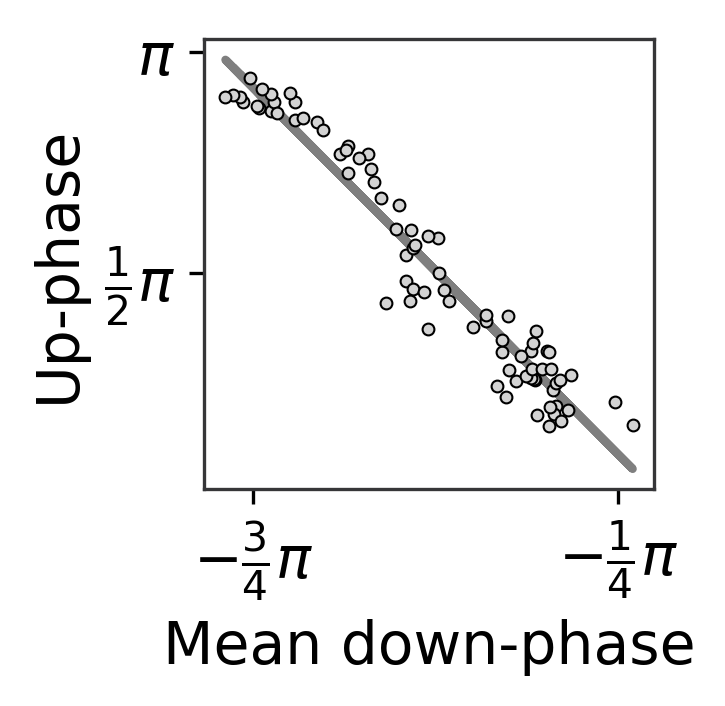

In [111]:
# plt.figure(figsize=(2, 2))
# plt.scatter(
#     node_mean_phases_down,
#     node_mean_phases_up,
#     s=8,
#     edgecolor="black",
#     linewidth=0.5,
#     c="lightgray",
# )
# bp.plot_linregress(node_mean_phases_down, node_mean_phases_up, kwargs={'c' : 'k', 'alpha' : 0.5, 'zorder' : -2})
# plt.xlabel("Mean down-phase")
# plt.ylabel("Up-phase")
bp.plot_transition_phases_against_eachother(node_mean_phases_down, node_mean_phases_up)
#plt.yticks([-np.pi/2, 0, np.pi/2], ["$-\\frac{1}{2}\\pi$", 0, "$\\frac{1}{2}\\pi$"])
plt.yticks([np.pi/2, np.pi], ["$\\frac{1}{2}\\pi$", "$\\pi$"])
plt.xticks([-1/4*np.pi, -3/4*np.pi], ["$-\\frac{1}{4}\\pi$", "$-\\frac{3}{4}\\pi$"])
plt.gca().tick_params(axis="both", direction="out", which="major", bottom=True, left=True)
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/down-phase-to-up-phase.pdf", transparent=True)

# Wave propagation

11385
59892
63735
102965
107253
565127
643761
695095
698800
702698
889409
893314
898056
988672
992700
996135
1066718
1071054
1229307
1280123
1353538
1487341
1491348
1495071
1576675
1671274
1750885
1754047
1758467
1761933
1819326
1822779
1828657
2026129
2029789
2111800
2151052
2156755
2160519
2242474
2336438
2386845
2391060
2398593
2525336
2580781
2807169
2845226
2848671
2989096
2993872
2998242
3029765
3124486
3222521
3225546
3300037
3388254
3392246
3465787
3492301
3497497
3503634
3590469
3633713
3637912
3715569
3719283
3744703
3761835
3765535
3769631
3845564
3992448
3995799
4061252
4139422
4142433
4244219
4247584
4251125
4307520
4414491
4436644
4514569
4519425
4561042
4566526
4570823
4705801
4769555
4773630
4864708
4868207
4871912
4908730
4914573
4985666
4989311
5164997
5198938
5203957
5208477
5414787
5464423
5577279


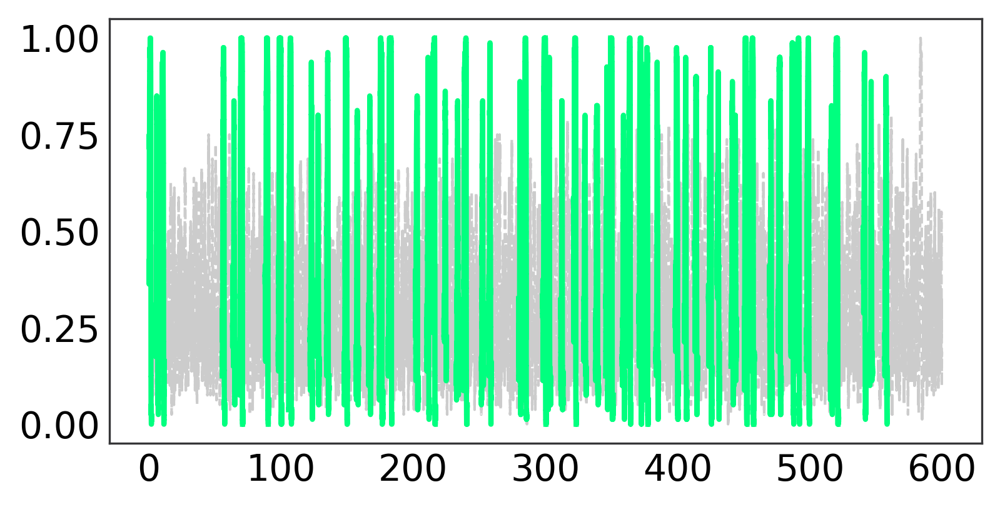

In [53]:
#dt_min = np.argsort(involvement)[::-1][15010]
plt.figure(figsize=(6, 3))
peaks = scipy.signal.find_peaks(involvement, height=0.8, distance=3000)[0]
peaks_ts = []
for num_p in range(1, len(peaks)-3):
    dt_min = peaks[num_p]

    #dt_min = scipy.signal.find_peaks(involvement)[0][1]
    print(dt_min)
    around = int(1000 / model.params.dt)
    plt.plot(model.t[dt_min-around : dt_min+around]/1000, involvement[dt_min-around : dt_min+around], c='springgreen')
    peaks_ts.append(involvement[dt_min-around : dt_min+around])
    down_transitions = np.diff(states)<0
    up_transitions = np.diff(states)>0
#     for i, downs in enumerate(down_transitions):
#         plt.vlines(np.where(downs)[0]*model.params.dt, 0.5, 1, lw=0.5, alpha=1, color=f"C1")
#     for i, ups in enumerate(up_transitions):
#         plt.vlines(np.where(ups)[0]*model.params.dt, 0, 0.5, lw=0.5, alpha=1, color=f"C0")

    #plt.xlim(model.t[dt_min-around], model.t[dt_min+around])
plt.plot(model.t/1000, involvement, c='k', zorder=-2, ls="--", lw=1, alpha=0.2)

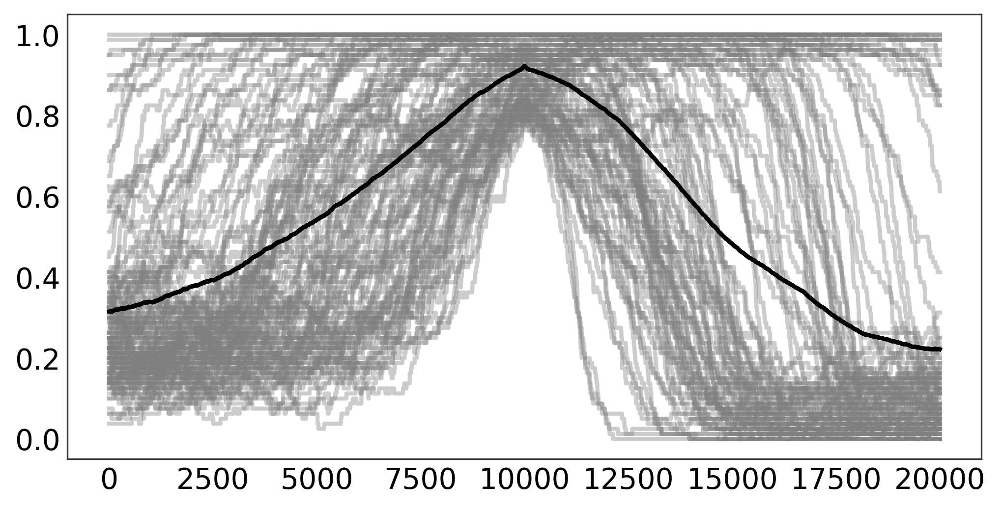

In [54]:
for p in peaks_ts:
    plt.plot(p, c='gray', alpha=0.4)
plt.plot(np.mean(np.array(peaks_ts), axis=0), c='k')

In [499]:
#dt_min = 430374 # peaks[num_p]

In [57]:
dt_min = peaks[-1]

(583385.2000000001, 585385.2000000001)

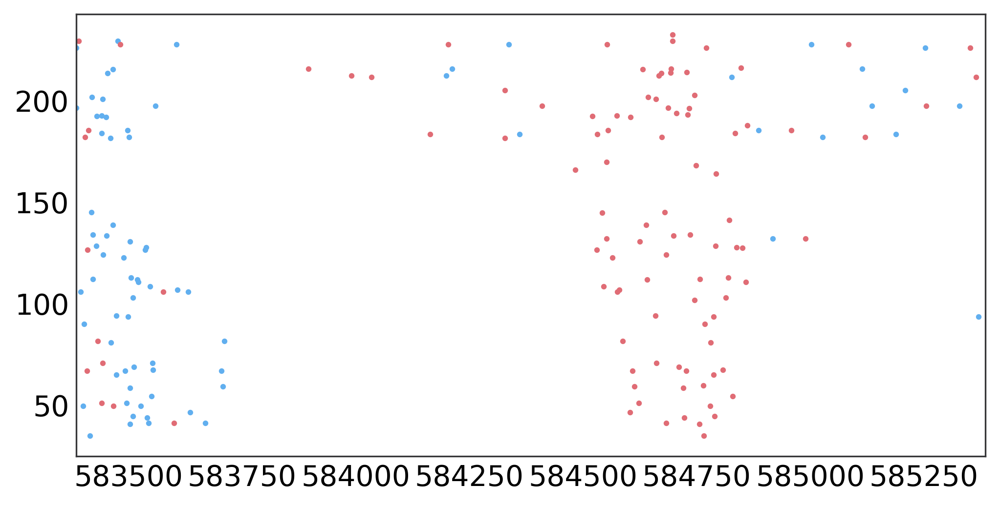

In [58]:
coords = atlas.coords()
for i, downs in enumerate(down_transitions):
    y_coord = coords[i][1]
    this_node_down_times = np.where(downs)[0]*model.params.dt
    plt.scatter(this_node_down_times, [y_coord] * len(this_node_down_times), c="C1", s=3)
plt.xlim(model.t[dt_min-around], model.t[dt_min+around])

coords = atlas.coords()
for i, ups in enumerate(up_transitions):
    y_coord = coords[i][1]
    this_node_up_times = np.where(ups)[0]*model.params.dt
    plt.scatter(this_node_up_times, [y_coord] * len(this_node_up_times), c="C0", s=3)
plt.xlim(model.t[dt_min-around], model.t[dt_min+around])

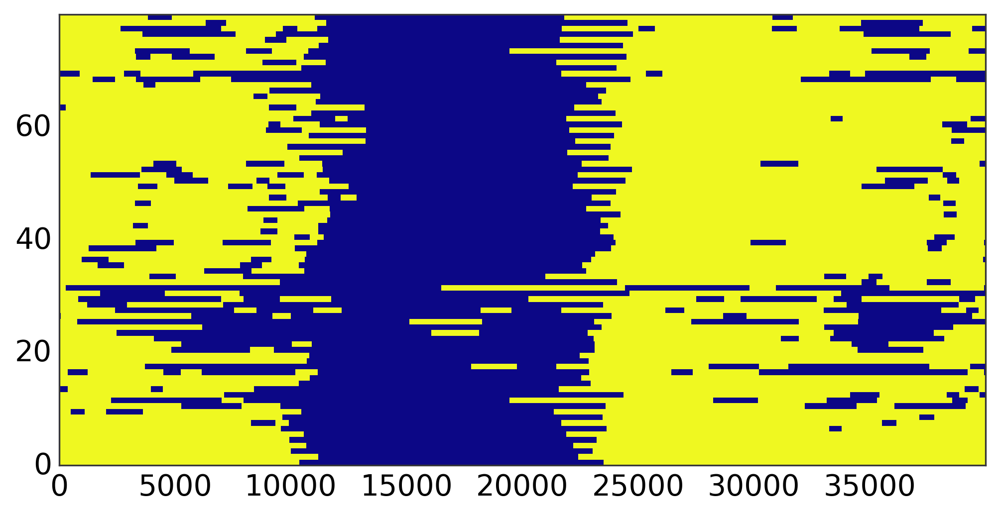

In [59]:
delta = 20000
plt.imshow(states[:, dt_min - delta : dt_min + delta], aspect='auto')

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<09:43, 10.29it/s]

-20000.0 75.0


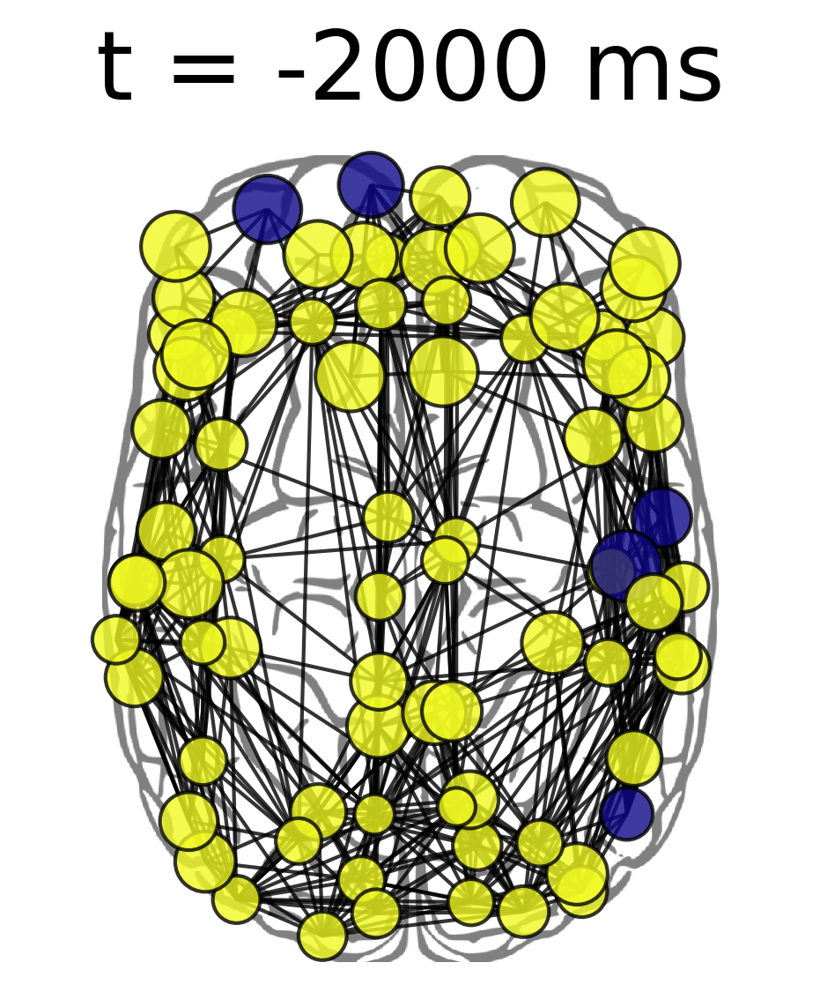

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<06:10, 16.20it/s]

-18500.0 72.0


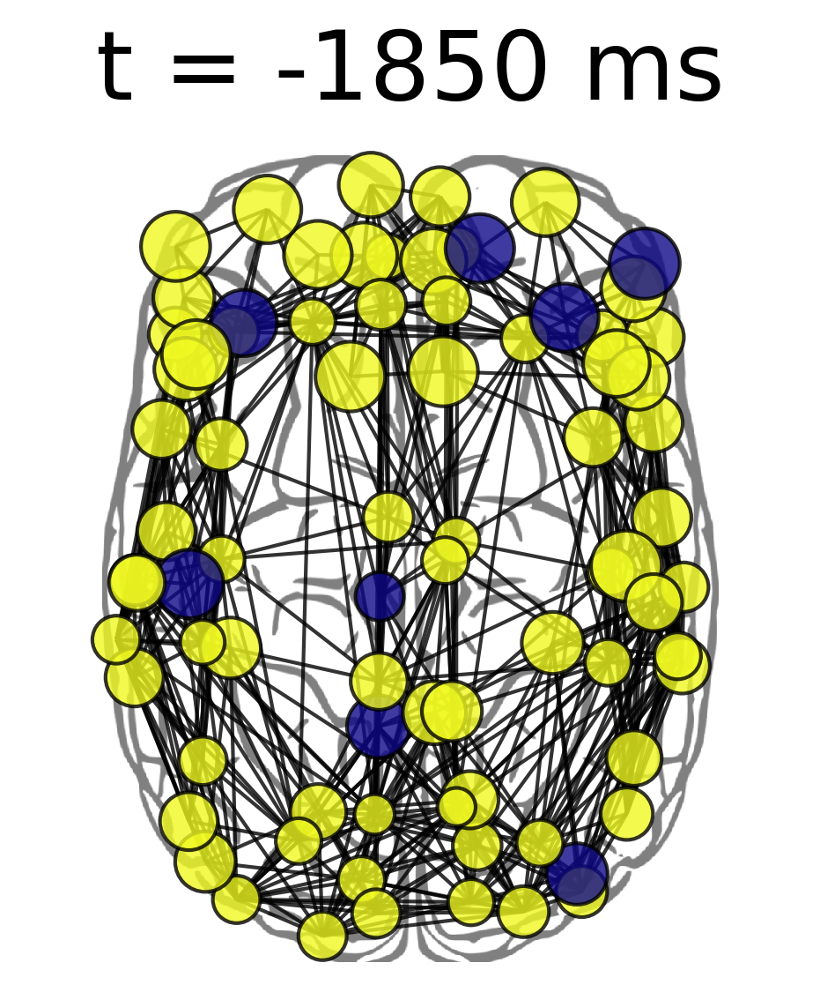

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<07:23, 13.54it/s]

-17000.0 68.0


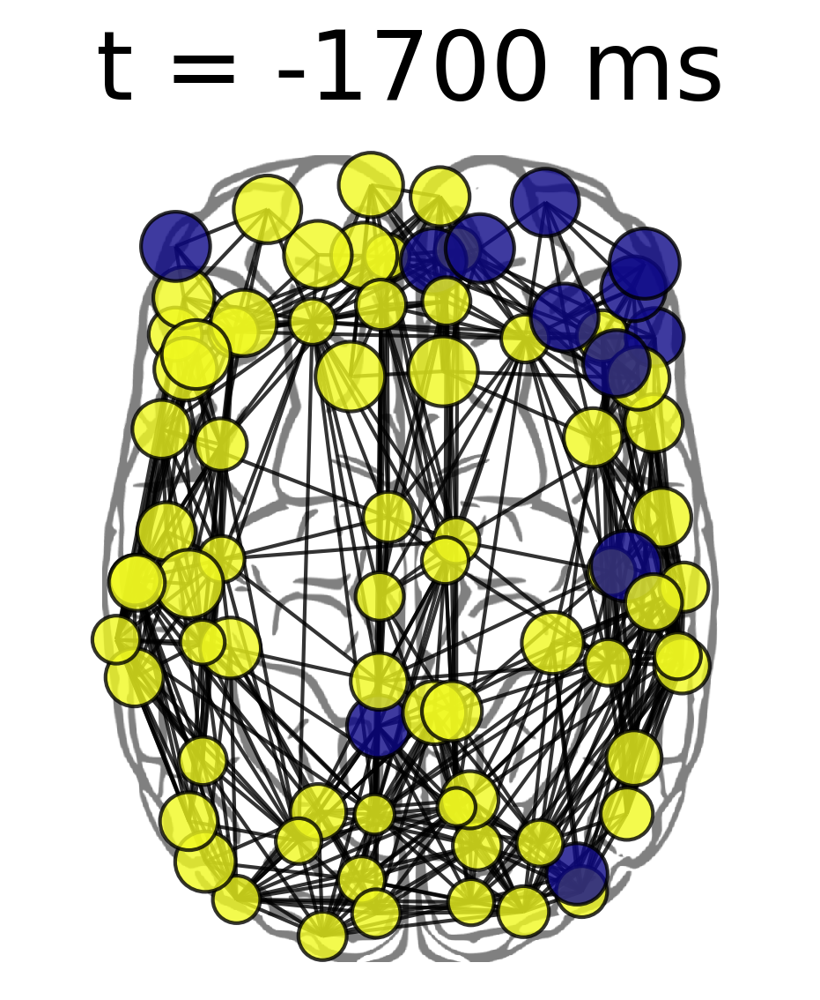

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:52, 17.00it/s]

-15500.0 62.0


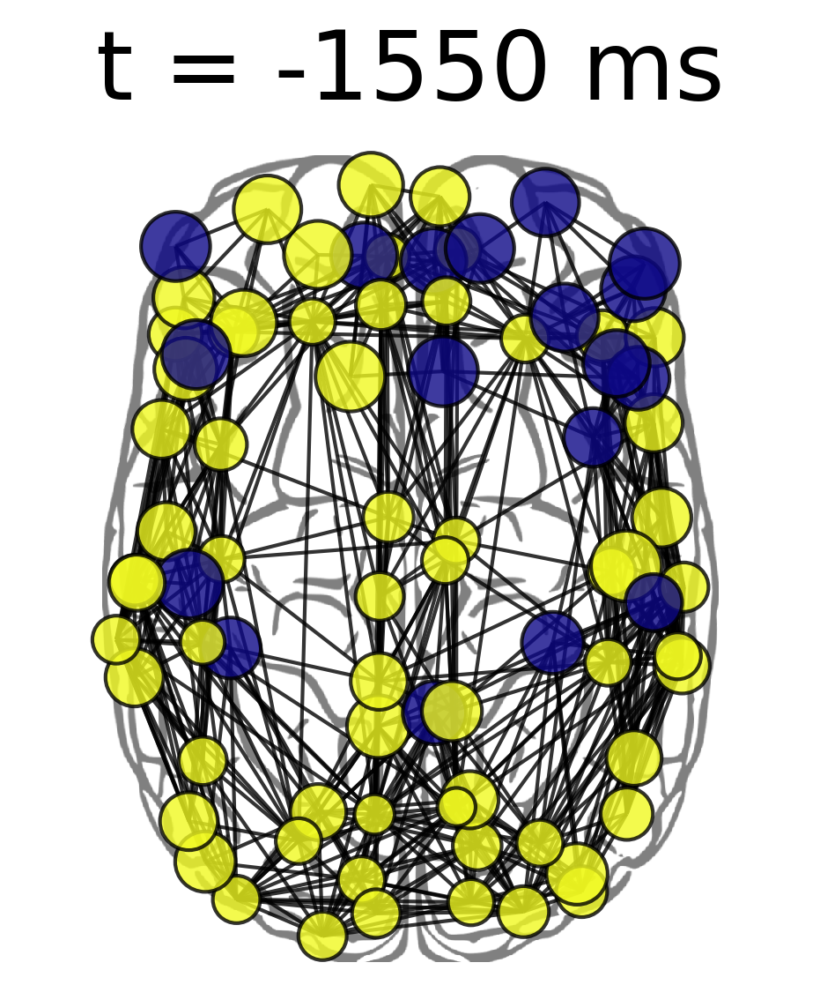

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<06:07, 16.32it/s]

-14000.0 62.0


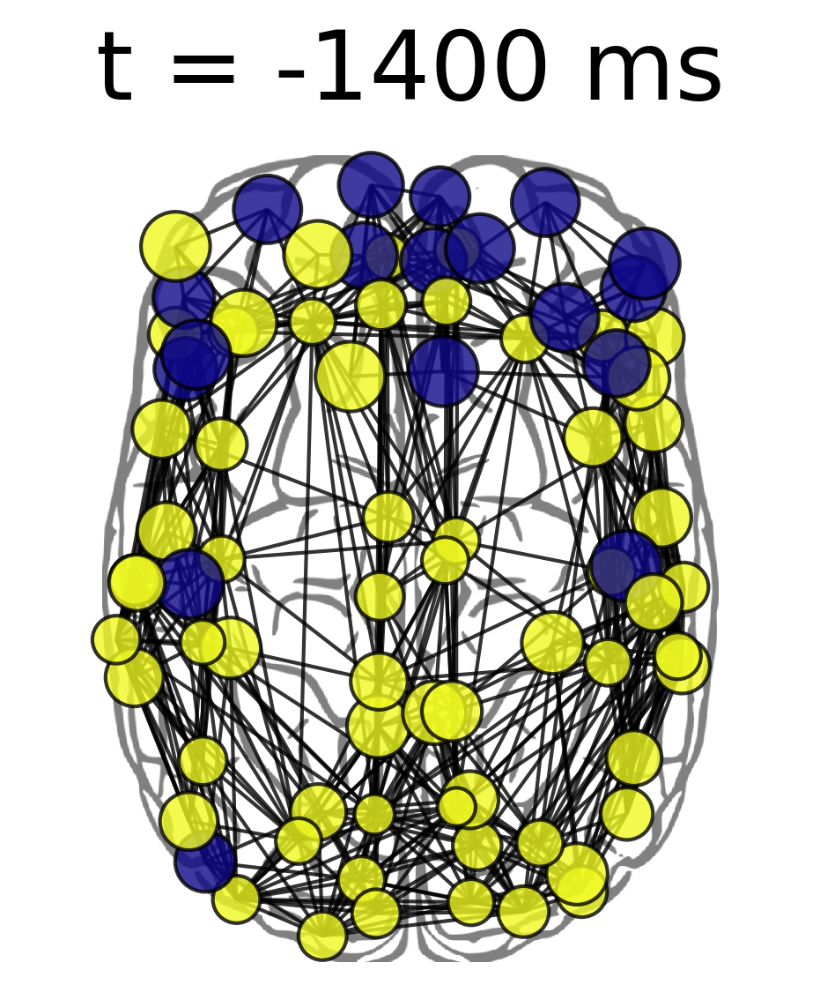

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:49, 17.15it/s]

-12500.0 60.0


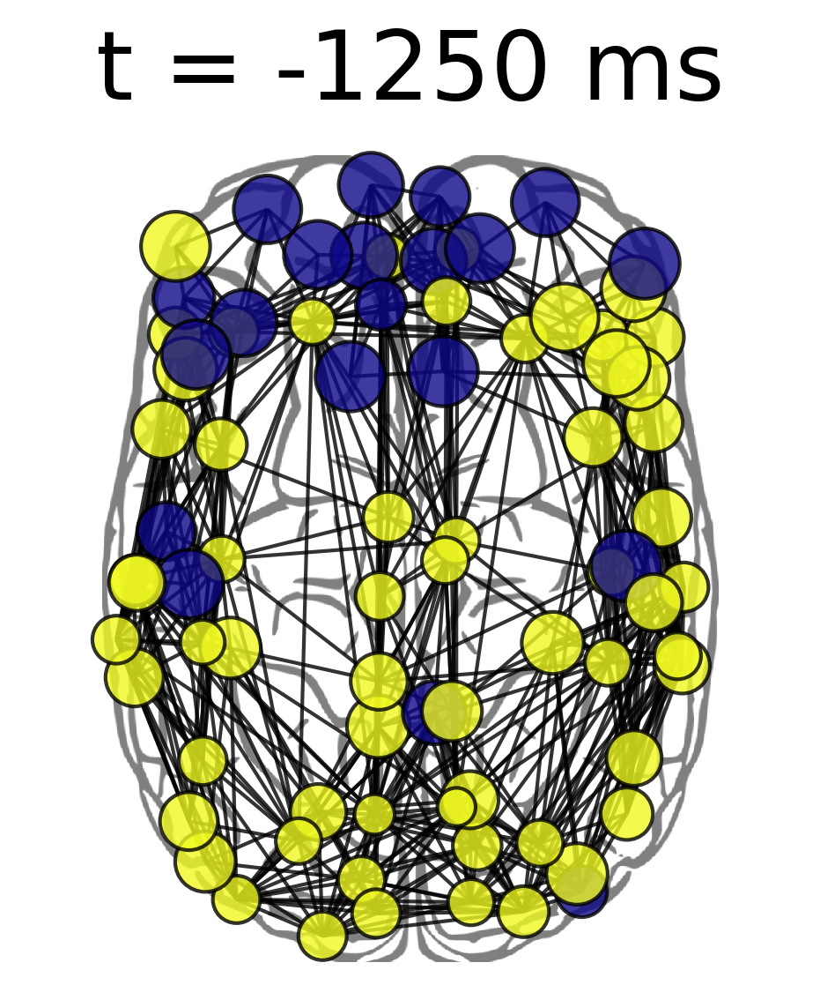

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:39, 17.66it/s]

-11000.0 48.0


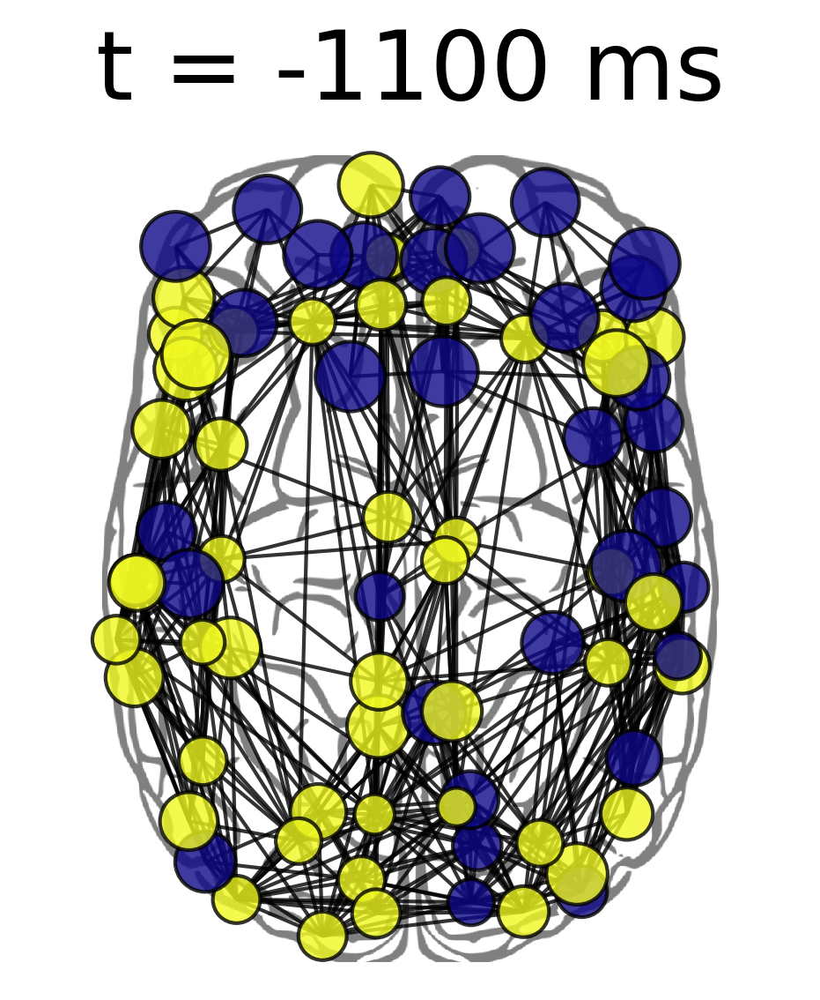

INFO:root:Defaulting to 6000 frames at 10 fp/s


-9500.0 41.0


  0%|          | 1/6000 [00:00<06:15, 15.96it/s]


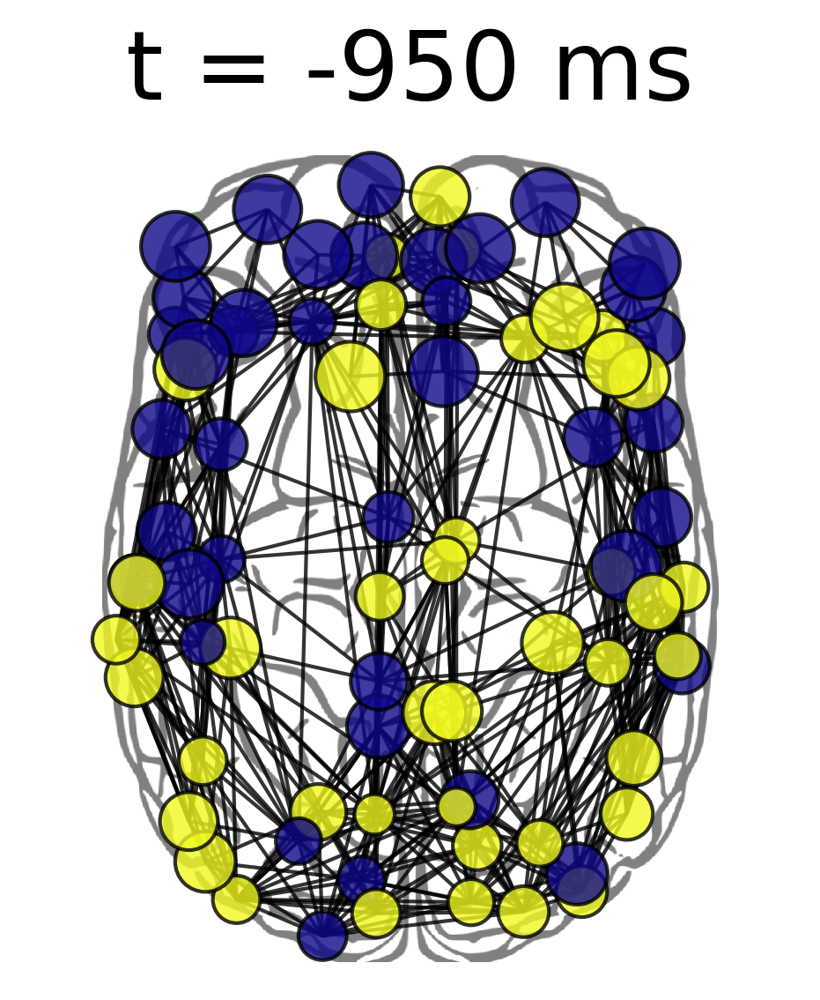

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:38, 17.72it/s]

-8000.0 7.0


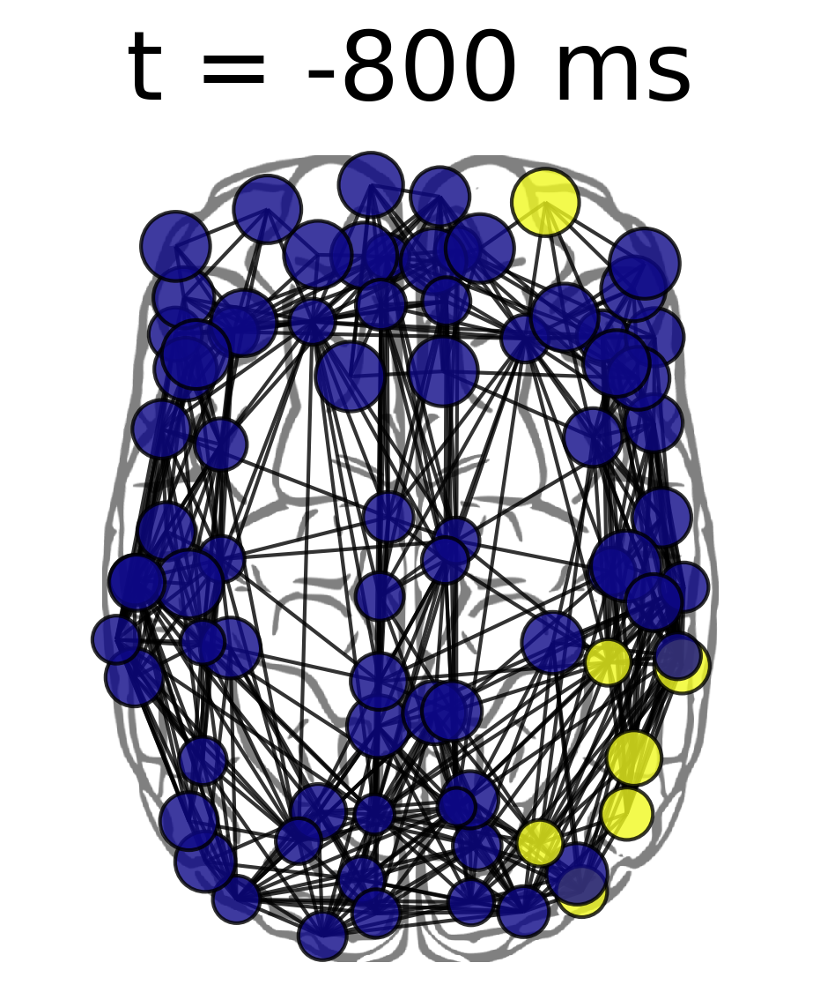

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:45, 17.38it/s]

-6500.0 0.0


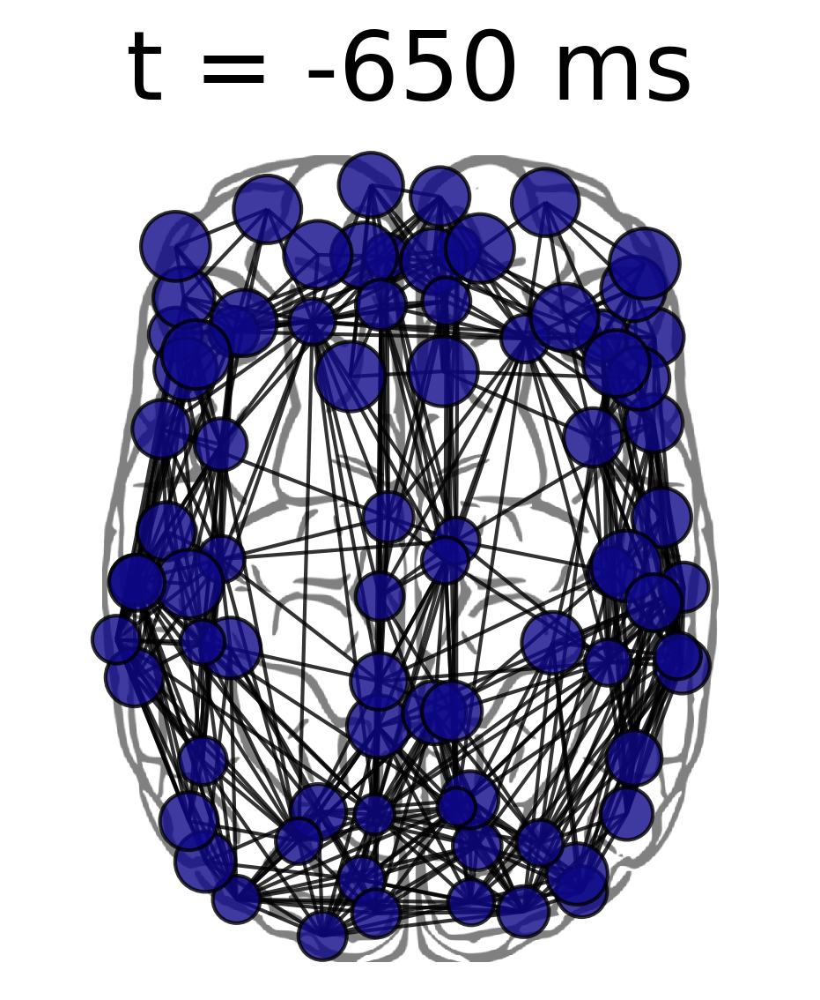

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:19, 18.80it/s]

-5000.0 0.0


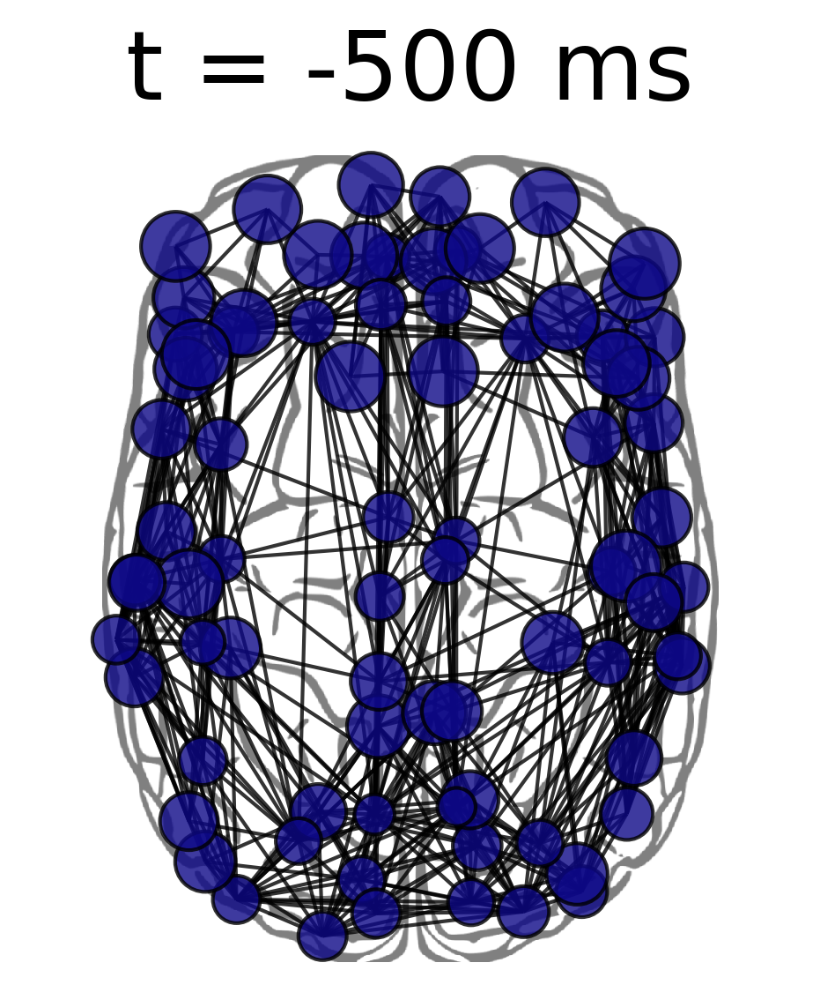

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:45, 17.34it/s]

-3500.0 3.0


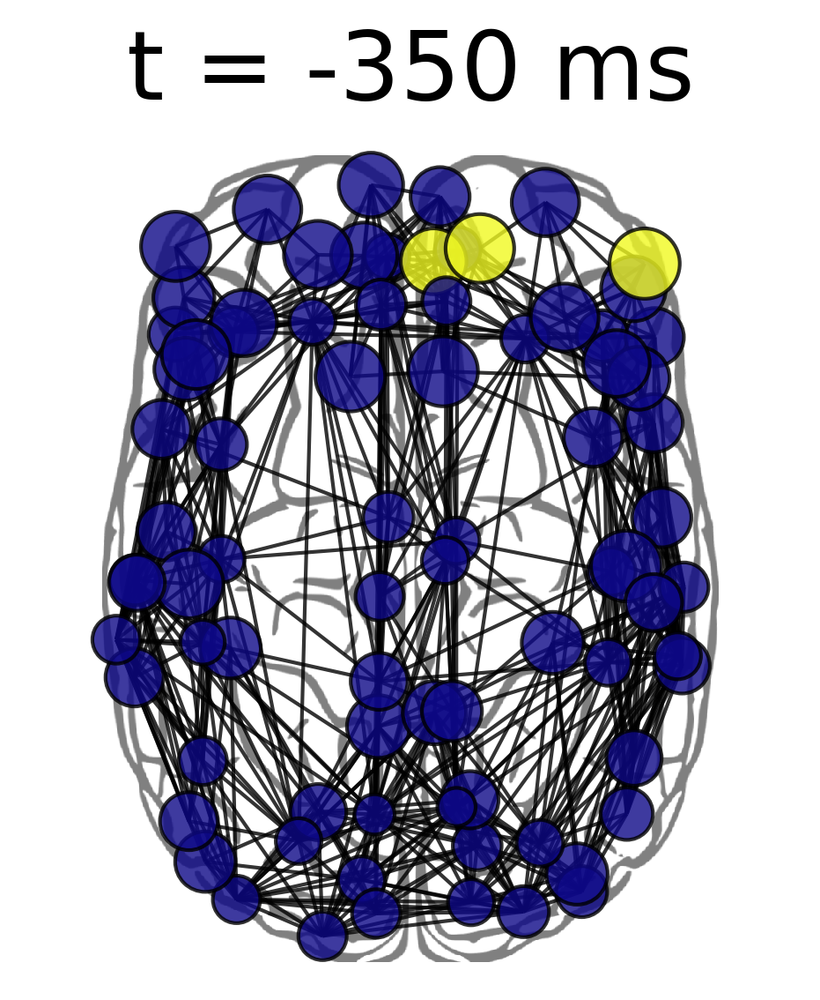

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<08:08, 12.28it/s]

-2000.0 4.0


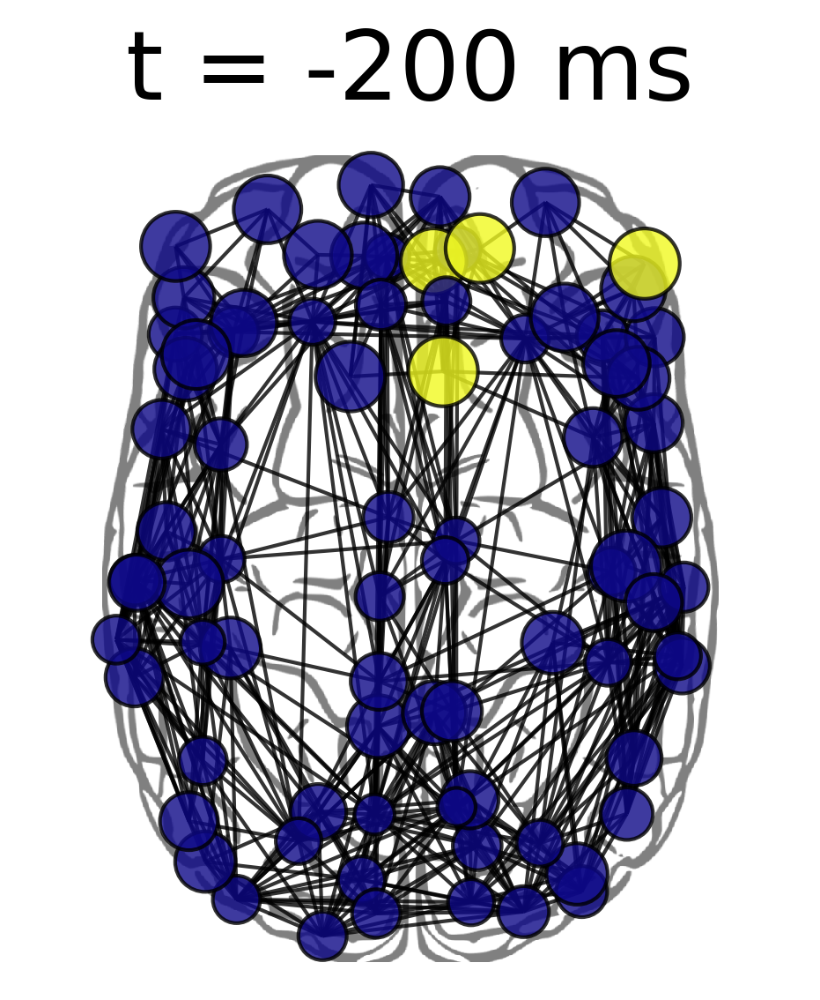

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<07:02, 14.19it/s]

-500.0 5.0


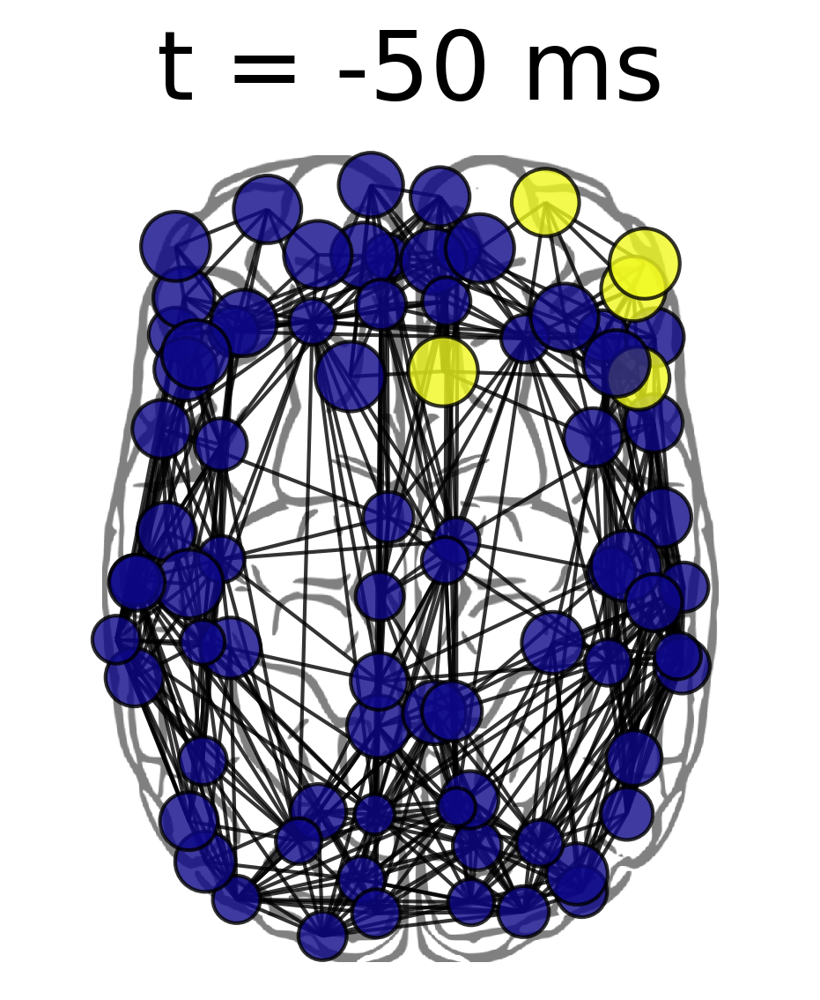

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<06:43, 14.87it/s]

1000.0 5.0


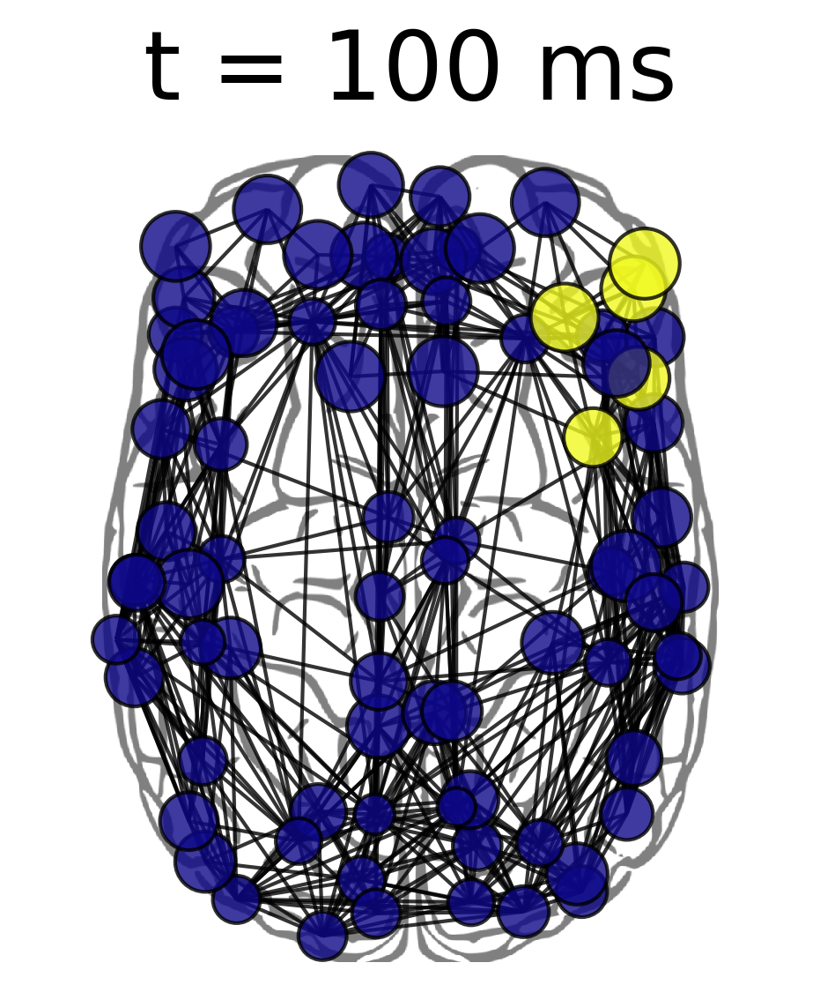

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<06:56, 14.39it/s]

2500.0 26.0


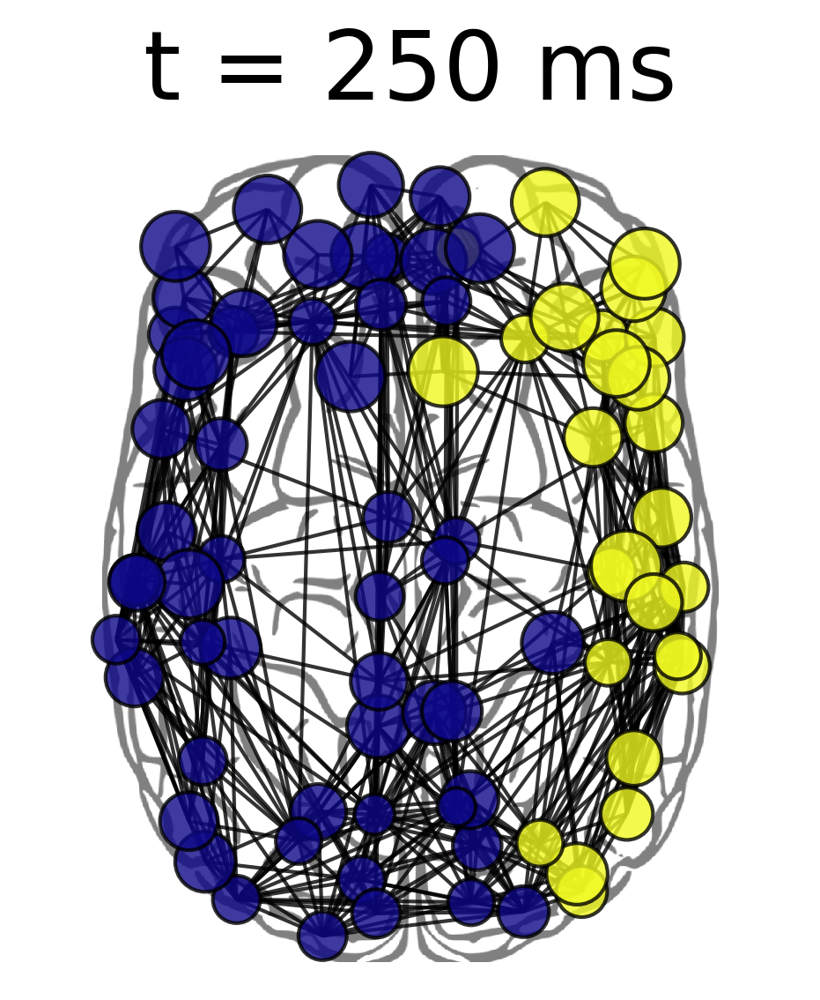

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<09:16, 10.78it/s]

4000.0 64.0


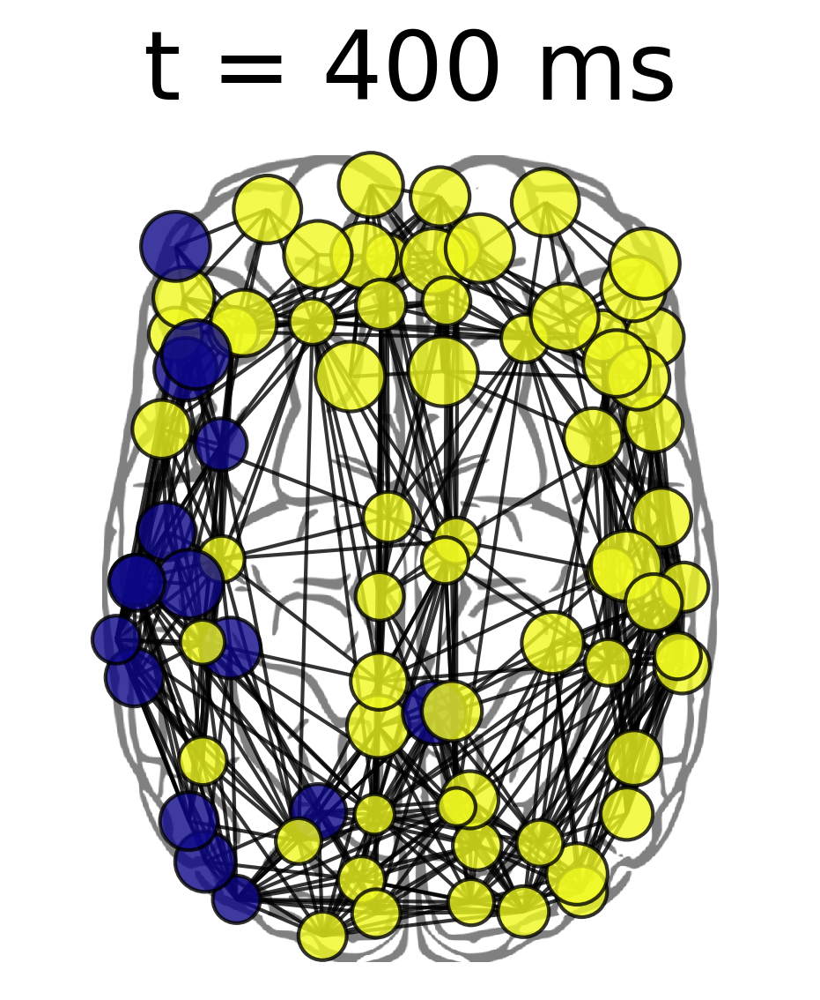

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:50, 17.09it/s]

5500.0 77.0


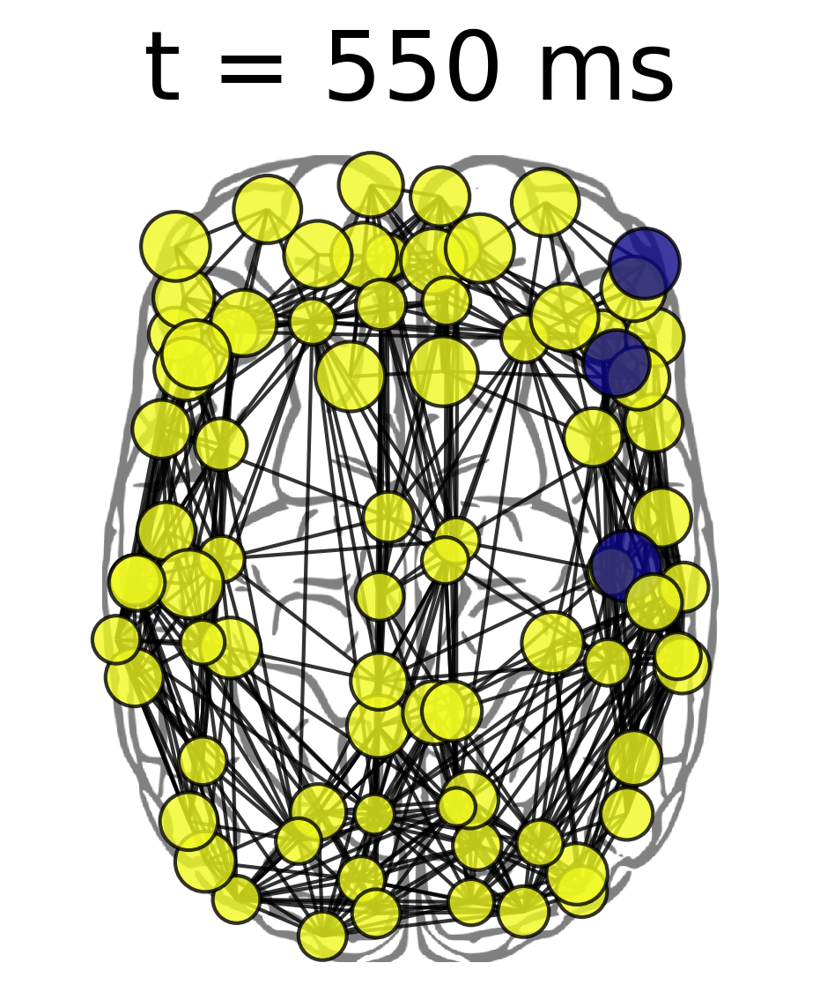

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<05:17, 18.89it/s]

7000.0 78.0


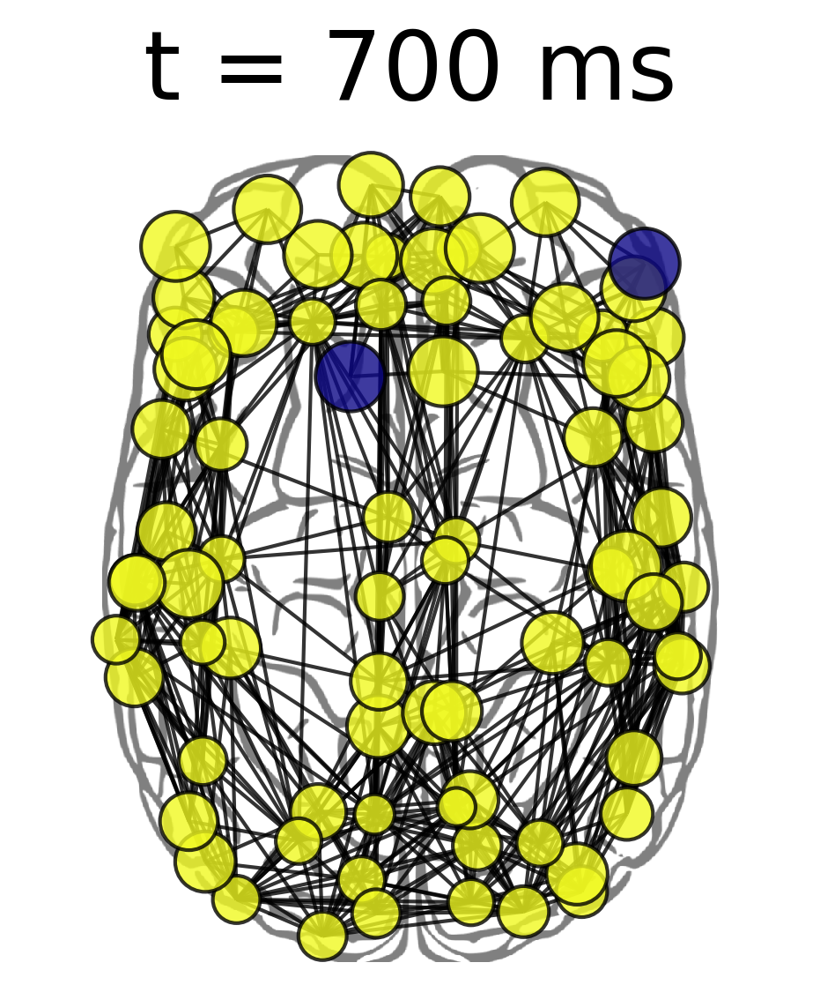

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<07:14, 13.82it/s]

8500.0 75.0


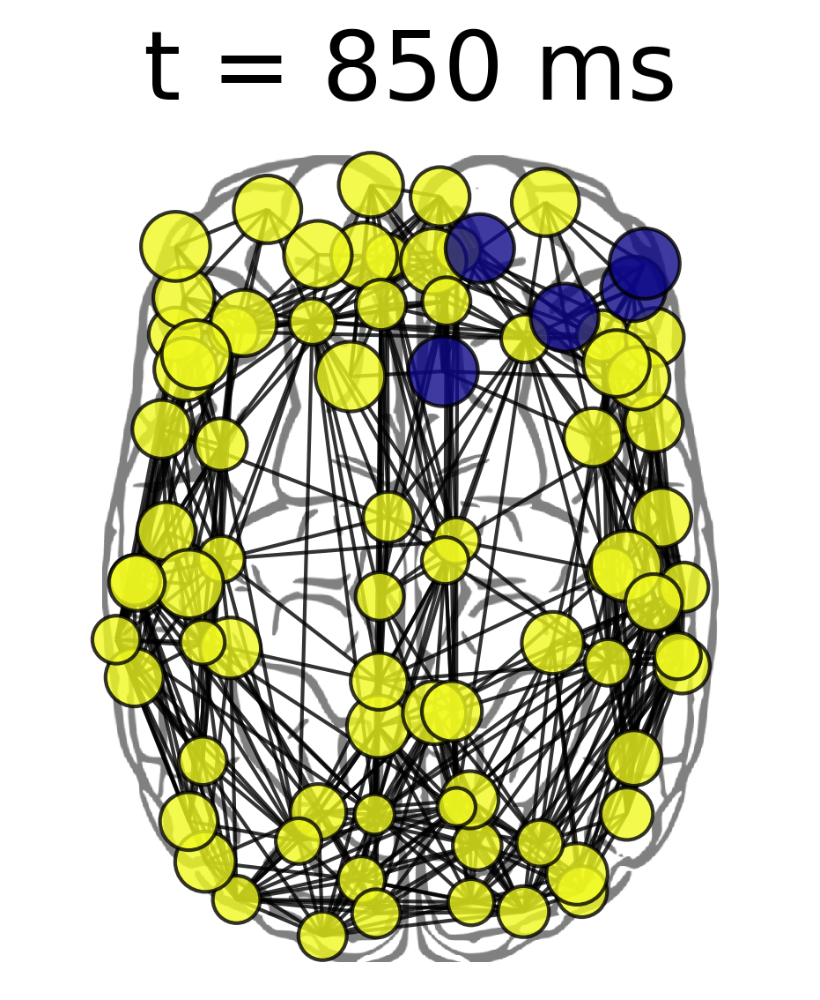

INFO:root:Defaulting to 6000 frames at 10 fp/s
  0%|          | 1/6000 [00:00<09:35, 10.42it/s]

10000.0 75.0


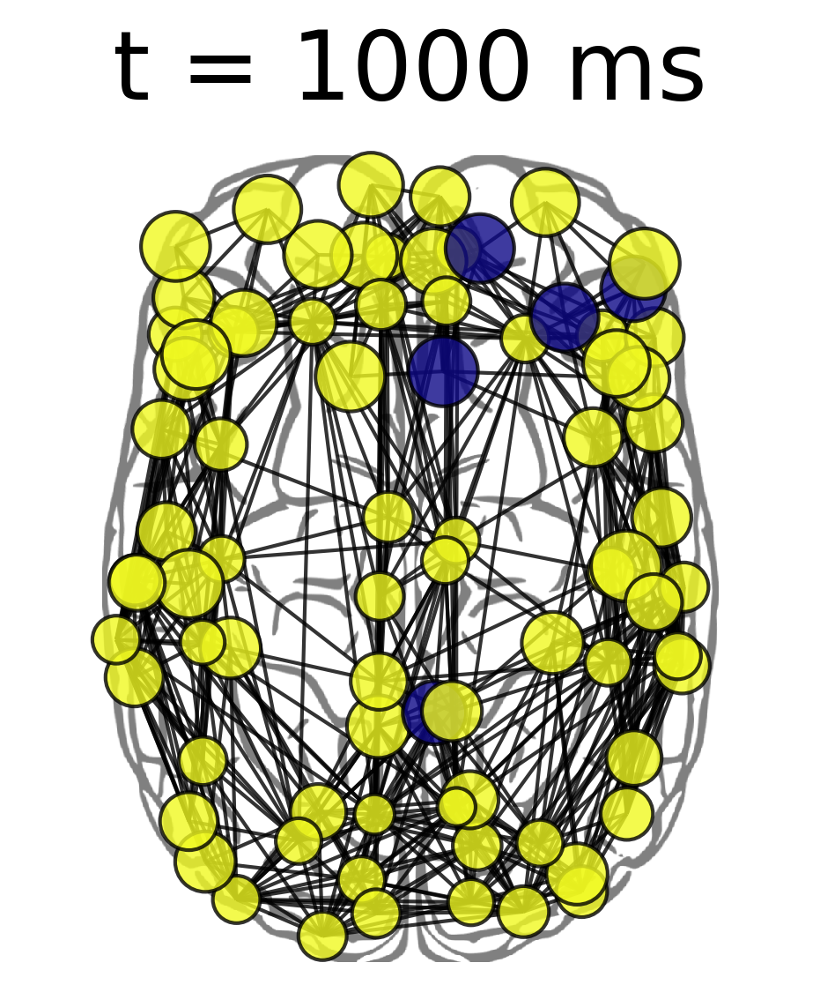

In [61]:
deltas = np.linspace(-20000, 10000, 21)
#deltas = [-15000, -10000, -5000, 0, 2000, 4000]
for delta in deltas:
    print(delta, np.sum(states[:, int(dt_min + delta)]))
    bp.plot_brain(model, ds, color=states[:, int(dt_min + delta)], size=np.multiply(-150, node_mean_phases_down), title=f"t = {int(delta*model.params.dt)} ms", cmap='plasma', cbar=False, clim=[0, 1])
    #plt.savefig(f"/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/frames/frame_{delta}.pdf", transparent=True)
    plt.show()
#plt.savefig("/Users/caglar/Documents/PhD/papers/2020-1-evolutionary-fitting/figures/assets/sleep_model/assets/brain_mean_phase.pdf", transparent=True)